### Librerias

In [1]:
# Data processing
# ==============================================================================
import numpy as np
from datetime import datetime
import pandas as pd
from pandas.api.types import is_numeric_dtype
from skforecast.datasets import fetch_dataset
from feature_engine.datetime import DatetimeFeatures
from feature_engine.creation import CyclicalFeatures
from feature_engine.timeseries.forecasting import WindowFeatures
from tqdm.auto import tqdm

# Plots
# ==============================================================================
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from skforecast.plot import plot_residuals, calculate_lag_autocorrelation
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as poff
pio.templates.default = "seaborn"
poff.init_notebook_mode(connected=True)

# Modelling and Forecasting
# ==============================================================================
import pmdarima as pm
import xgboost
import lightgbm
import catboost
import sklearn
import shap
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.preprocessing import (
    OneHotEncoder,
    OrdinalEncoder,
    FunctionTransformer,
    PolynomialFeatures,
)
from sklearn.feature_selection import RFECV
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer, make_column_selector

import skforecast
from skforecast.recursive import ForecasterEquivalentDate, ForecasterRecursive
from skforecast.utils import save_forecaster, load_forecaster
from skforecast.model_selection import (
    TimeSeriesFold,
    OneStepAheadFold,
    bayesian_search_forecaster,
    backtesting_forecaster,
)
from skforecast.preprocessing import RollingFeatures
from skforecast.feature_selection import select_features
from skforecast.metrics import calculate_coverage
from statsmodels.tsa.stattools import acf, adfuller, grangercausalitytests, kpss, pacf

import optuna
from optuna import create_study
from copy import deepcopy
optuna.logging.set_verbosity(optuna.logging.WARNING)

# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('once')
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

C:\Users\ianla\AppData\Roaming\Python\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
%%html
<style>
.cell-output-ipywidget-background {
    background-color: transparent !important;
}
:root {
    --jp-widgets-color: var(--vscode-editor-foreground);
    --jp-widgets-font-size: var(--vscode-editor-font-size);
}  
</style>

### Funciones

In [3]:
# La función split_data(data, test_split) divide un conjunto de datos en dos partes: un conjunto de entrenamiento y uno de prueba.
# El parámetro test_split define la proporción de los datos que se destinarán al conjunto de prueba. La función imprime las longitudes de ambos conjuntos y los retorna.
def split_data(data, test_split, print_len = True):
    l = len(data)
    t_idx = round(l*(1-test_split))
    train, test = data[ :t_idx], data[t_idx: ]
    if print_len:
        print(f'train: {len(train)} , test: {len(test)}')
    return train, test

In [4]:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / np.where(y_true == 0, np.nan, y_true)))

def rmse(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

def rmspe(y_true, y_pred):
    return np.sqrt(np.mean(((y_true - y_pred) / np.where(y_true == 0, np.nan, y_true)) ** 2))

In [5]:
# La función get_error_metrics(...) calcula métricas de error (RMSE, MAPE y RMSPE) entre predicciones y valores reales,
#  y retorna un DataFrame con los resultados etiquetados según el modelo y la técnica utilizados.
def get_error_metrics(y_pred, y_test, model):

    # Calcular métricas de error
    residuals = y_test.values - y_pred.values
    rmse = np.sqrt(np.mean(residuals**2))
    mape = np.mean(np.abs(residuals / y_test.values)) 
    rmspe = np.sqrt(np.mean((residuals / y_test.values) ** 2))

    # Crear un registro con los resultados del modelo
    nuevo_resultado = {
        "Model" : [f"{model}"],
        "RMSPE": rmspe,
        "RMSE": rmse,
        "MAPE": mape
    }

    return pd.DataFrame(nuevo_resultado)

In [6]:
def check_stationarity(timeseries):
    result = adfuller(timeseries)
    return result[1]

In [7]:
def to_category(x):
    return x.astype('category')

pipeline_categorical = make_pipeline(
    OrdinalEncoder(
        dtype=int,
        handle_unknown="use_encoded_value",
        unknown_value=-1,
        encoded_missing_value=-1
    ),
    FunctionTransformer(
        func=to_category,
        feature_names_out='one-to-one'
    )
)
transformer_exog = make_column_transformer(
    (
        pipeline_categorical,
        make_column_selector(dtype_include=['category', 'object']),
    ),
    remainder="passthrough",
    verbose_feature_names_out=False,
).set_output(transform="pandas")

## SARIMA

In [47]:
df = pd.read_csv('Resultados CSV/df_agua_forecast.csv', parse_dates=["Fecha"])
df = df.sort_values(by="Fecha", ascending=True)
df = df.set_index("Fecha", drop=False).rename_axis('idx_fecha')
exog_features = [col for col in df.columns if col not in (["Nombre Corto", "Localidad","Tipo Cliente", "M3 Ap", "id_combinacion", "Fecha"])]
combination = [x for x in df["id_combinacion"].unique() if 'BUIN' in x]

df_agua = df.copy()

In [46]:
modelos_arima = {
    'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Comercial': pm.ARIMA(order=(9,0,7), seasonal_order=(0,0,0,12)),
    'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial': pm.ARIMA(order=(1,0,0), seasonal_order=(2,0,2,6)),
    'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Institucional': pm.ARIMA(order=(2,0,2), seasonal_order=(0,1,1,12)),
    'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;No Asociado a Inmueble': pm.ARIMA(order=(0,1,0), seasonal_order=(2,0,1,12)),
    'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial': pm.ARIMA(order=(2,1,1), seasonal_order=(1,0,1,6)),
}

In [ ]:
score = {}
forecast_sarima = {}
start_time = datetime.now()
for id in tqdm(combination, desc="SARIMA training"):
    df_forecast = df[(df["id_combinacion"] == id)]
    df_forecast = df_forecast.set_index("Fecha").sort_index()
    # Split train/test
    water_train, water_test = split_data(df_forecast["M3 Ap"].reset_index(drop=True), 60/156, False)

    m =  modelos_arima[id]
    res = m.fit(water_train)

    y = water_test.values.ravel()
    y_hat = res.predict(60)

    score_key = f"{id}"
    score[score_key] = {
        'order': res.order,
        'ID': id,
        'Technique': "SARIMA",
        'RMSPE': rmspe(y, y_hat),
        'RMSE': rmse(y, y_hat),
        'MAPE': mape(y, y_hat),
        'model': res
    }
    forecast_sarima[id] = [{
        'metric': {'RMSPE': rmspe(y, y_hat),'RMSE': rmse(y, y_hat),'MAPE': mape(y, y_hat)},
        'order':  res.order,
        'water_test': water_test,
        'forecast': y_hat,
        'model': res,
        'fecha':df_forecast.index[-60:]
    }]
model_score = pd.DataFrame.from_dict(score, orient='index')
end_time = datetime.now()

rows = []

for id_val, entries in forecast_sarima.items():
    for entry in entries:
        water = entry['water_test']
        forecast = entry['forecast']
        fecha = entry['fecha']
        for i, (wt, fc, fech) in enumerate(zip(water, forecast, fecha)):
            rows.append({
                'id': id_val,
                'Test': wt,
                'SARIMA': fc,
                'Fecha': fech
            })

# Crear DataFrame en formato long
df_long = pd.DataFrame(rows)


In [51]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,14), dpi=600)
axs = axs.flatten()

for i, id in enumerate(combination):
    sns.lineplot(data=df[df["id_combinacion"] == id], x="Fecha", y="M3 Ap", ax=axs[i], label="Test", color="#3CA6A6")
    sns.lineplot(data=df_long[df_long["id"] == id], x="Fecha", y="SARIMA", ax=axs[i], label="SARIMA")
    axs[i].set_title(id, fontsize=10)

In [52]:
df_long["Grupo Cliente"] = df_long["id"].apply(lambda x: "Residencial" if 'Residencial' in x else "No Residencial")

Text(0.5, 0.98, 'Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

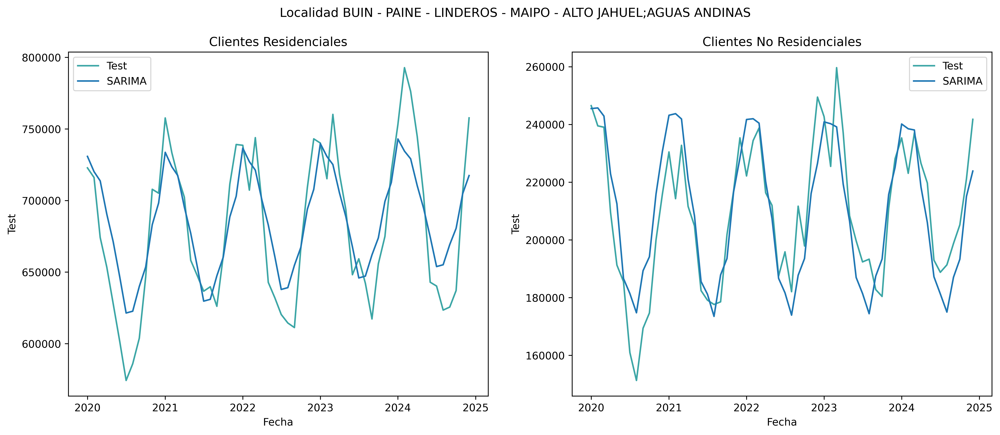

In [53]:
aux = df_long.groupby(by=["Fecha", "Grupo Cliente"], as_index=False)[["Test", "SARIMA"]].sum()

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=600)

sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="Test", ax=axs[0], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="SARIMA", ax=axs[0], label="SARIMA")
axs[0].set_title("Clientes Residenciales")

sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="Test", ax=axs[1], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="SARIMA", ax=axs[1], label="SARIMA")
axs[1].set_title("Clientes No Residenciales")

fig.suptitle('Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

In [56]:
get_error_metrics(aux[aux["Grupo Cliente"] == "Residencial"]["SARIMA"], aux[aux["Grupo Cliente"] == "Residencial"]["Test"], "ARIMA", "Residencial")


,Model,RMSPE,RMSE,MAPE
0,ARIMA-Residencial,0.040627,26929.046442,0.032892


In [57]:
get_error_metrics(aux[aux["Grupo Cliente"] == "No Residencial"]["SARIMA"], aux[aux["Grupo Cliente"] == "No Residencial"]["Test"], "ARIMA", "No Residencial")


,Model,RMSPE,RMSE,MAPE
0,ARIMA-No Residencial,0.06336,12701.61979,0.05124


In [ ]:
df_long.to_csv("Resultados CSV/forecast_sarima.csv", index=False)

## One Model

### Preprocesamiento

In [8]:
df = pd.read_csv('Resultados CSV/df_agua_forecast.csv', parse_dates=["Fecha"])
df = df.sort_values(by="Fecha", ascending=True)
df = df.set_index("Fecha", drop=False).rename_axis('idx_fecha')
exog_features = [col for col in df.columns if col not in (["Nombre Corto", "Localidad","Tipo Cliente", "M3 Ap", "id_combinacion", "Fecha"])]
combination = [x for x in df["id_combinacion"].unique() if 'BUIN' in x]

df_agua = df.copy()

In [9]:
combination

['BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Comercial',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;No Asociado a Inmueble',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Institucional',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial']

In [10]:
i = 2
id = combination[i]
df = df[df["id_combinacion"] == combination[i]].asfreq("MS").sort_index()

In [11]:
df_ml = df.copy()
end_train = '2017-12-01'
end_validation = '2019-12-01'
start_test = '2020-01-01'
end_test = '2024-12-01'

y_train    = df_ml.loc[:end_train,:]
y_trainval = df_ml.loc[:end_validation,:]
y_test     = df_ml.loc[start_test:,]  # Últimos 60 datos

# Variables exógenas si las usas
X_train    = y_train[exog_features]
X_trainval = y_trainval[exog_features]
X_test     = y_test[exog_features]

### LightGBM

In [12]:
# Diferenciacion
d = 0
i = 0
aux = df['M3 Ap']
while check_stationarity(aux) > 0.05 and i < 3:
    aux = aux.diff().dropna()
    d += 1
    i += 1
print(d)

1


In [50]:
# -------------------------------------------------------------------
# 1. Definir espacio de búsqueda de hiperparámetros (sin cambios)
# -------------------------------------------------------------------
def search_space(trial):
    return {
        'boosting_type': trial.suggest_categorical('boosting_type', ['dart','gbdt','rf']),
        'lags': trial.suggest_int('lags', 6, 32),
        'n_estimators': trial.suggest_int('n_estimators', 2, 12),
        'max_bin': trial.suggest_int('max_bin', 2, 35),
        'max_depth': trial.suggest_int('max_depth', 2, 10),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 10, step=1),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 20),
        'min_child_samples': trial.suggest_int('min_child_samples', 2, 20),
        'min_data_in_bin': trial.suggest_int('min_data_in_bin', 3, 20),
        'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.01),
        'feature_fraction': trial.suggest_float('feature_fraction', 0.05, 0.8, step=0.05),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.1, 0.9, step=0.1),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.1, 0.9, step=0.1),
        'linear_tree': trial.suggest_categorical('linear_tree', [True, False]),
        'windows_sizes':trial.suggest_int("windows_sizes", 0, 24, step=2)
    }


In [51]:
# -------------------------------------------------------------------
# 2. Ciclo de evaluación: búsqueda + evaluación inmediata en test
# -------------------------------------------------------------------

# Lista para guardar resultados extendidos
resultados = []
cv_search = TimeSeriesFold(steps=60, initial_train_size=36, differentiation=d, refit=True, fixed_train_size=False)#
# Búsqueda manual de hiperparámetros con evaluación real
def objective(trial):
    # Obtener parámetros del espacio de búsqueda
    params = search_space(trial)
    copy_params = search_space(trial)
    lags = params.pop('lags')
    windows_sizes = params.pop("windows_sizes")

    window_features = RollingFeatures(
    stats = ['mean', 'std', 'min', 'max'],
    window_sizes = windows_sizes
    )

    # Crear forecaster
    forecaster = ForecasterRecursive(
        regressor=LGBMRegressor(random_state=8520,verbose=-1 ,num_iterations= 100, **params),
        lags=lags,
        transformer_exog = transformer_exog,
        window_features  = window_features if windows_sizes > 0 else None,
        fit_kwargs       = {"categorical_feature": "auto"},
        differentiation  = d
    )

    # Backtesting dentro del conjunto de entrenamiento + validación
    metricas_cv, _ = backtesting_forecaster(
        forecaster=forecaster,
        y=y_trainval['M3 Ap'],
        exog=X_trainval[exog_features],
        cv=cv_search,
        metric=[rmse, mape, rmspe],
        show_progress= False,
        random_state=8520
    )

    forecaster.fit(y=y_trainval['M3 Ap'], exog=X_trainval)
    # Evaluar directamente en el conjunto de test
    y_pred = forecaster.predict(steps=60, exog=X_test)

    mape_test = mape(y_test["M3 Ap"], y_pred)
    rmse_test = rmse(y_test["M3 Ap"], y_pred)
    rmspe_test = rmspe(y_test["M3 Ap"], y_pred)

    # Guardar resultados extendidos
    resultados.append({
        'params': copy_params,
        'lags': lags,
        'rmse_cv': metricas_cv['rmse'].values[0],
        'mape_cv': metricas_cv['mape'].values[0],
        'rmspe_cv': metricas_cv['rmspe'].values[0],
        'mape_test': mape_test,
        'rmse_test': rmse_test,
        'rmspe_test': rmspe_test
    })

    return metricas_cv['rmspe'].values[0]  # objetivo para minimizar en la búsqueda

sampler = optuna.samplers.TPESampler(seed=8520)
study = create_study(direction='minimize', sampler=sampler)

study.optimize(objective, n_trials=5000, show_progress_bar=True, gc_after_trial=True)

Best trial: 4266. Best value: 0.0473215: 100%|██████████| 5000/5000 [51:37<00:00,  1.61it/s]


In [52]:
# Convertir resultados a DataFrame
resultados_df = pd.DataFrame(resultados)

# Calcular ponderaciones usando normalización min-max (minimizar)
for metric in ['mape_test', 'rmse_test', 'rmspe_test', 'mape_cv', 'rmse_cv', 'rmspe_cv']:
    min_val = resultados_df[metric].min()
    max_val = resultados_df[metric].max()
    resultados_df[f'{metric}_norm'] = (resultados_df[metric] - min_val) / (max_val - min_val)

resultados_df["Ponderacion_test"] = resultados_df[['mape_test_norm', 'rmse_test_norm', 'rmspe_test_norm']].mean(axis=1)
resultados_df["Ponderacion_cv"] = resultados_df[['mape_cv_norm', 'rmse_cv_norm', 'rmspe_cv_norm']].mean(axis=1)
resultados_df["Ponderacion"] = (resultados_df["Ponderacion_cv"] + resultados_df["Ponderacion_test"]) / 2 * 100

resultados_df.sort_values(by="Ponderacion", ascending=True)

,params,lags,rmse_cv,mape_cv,rmspe_cv,mape_test,rmse_test,rmspe_test,mape_test_norm,rmse_test_norm,rmspe_test_norm,mape_cv_norm,rmse_cv_norm,rmspe_cv_norm,Ponderacion_test,Ponderacion_cv,Ponderacion
1410,"{'boosting_type': 'rf', 'lags': 19, 'n_estimat...",19,4.270598e+04,5.560991e-02,6.911212e-02,2.094702e-02,1.801126e+04,2.612581e-02,0.000000e+00,0.000000e+00,0.000000e+00,3.639945e-101,6.468478e-102,6.335538e-102,0.000000e+00,1.640116e-101,8.200578e-100
1489,"{'boosting_type': 'rf', 'lags': 19, 'n_estimat...",19,2.926388e+04,4.113469e-02,4.869332e-02,2.171703e-02,1.843854e+04,2.687767e-02,6.857387e-80,6.842349e-81,9.121261e-81,4.502782e-102,8.292743e-103,3.988509e-103,2.817916e-80,1.910302e-102,1.408958e-78
1346,"{'boosting_type': 'rf', 'lags': 19, 'n_estimat...",19,2.926388e+04,4.113469e-02,4.869332e-02,2.171703e-02,1.843854e+04,2.687767e-02,6.857387e-80,6.842349e-81,9.121261e-81,4.502782e-102,8.292743e-103,3.988509e-103,2.817916e-80,1.910302e-102,1.408958e-78
1339,"{'boosting_type': 'rf', 'lags': 19, 'n_estimat...",19,2.926388e+04,4.113469e-02,4.869332e-02,2.171703e-02,1.843854e+04,2.687767e-02,6.857387e-80,6.842349e-81,9.121261e-81,4.502782e-102,8.292743e-103,3.988509e-103,2.817916e-80,1.910302e-102,1.408958e-78
1360,"{'boosting_type': 'rf', 'lags': 19, 'n_estimat...",19,2.926388e+04,4.113469e-02,4.869332e-02,2.171703e-02,1.843854e+04,2.687767e-02,6.857387e-80,6.842349e-81,9.121261e-81,4.502782e-102,8.292743e-103,3.988509e-103,2.817916e-80,1.910302e-102,1.408958e-78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34,"{'boosting_type': 'dart', 'lags': 8, 'n_estima...",8,6.426603e+26,2.005487e+20,9.645940e+20,8.513449e+52,4.492482e+59,5.933293e+53,7.581696e-24,7.194107e-24,7.198100e-24,4.419162e-79,2.696077e-79,2.804520e-79,7.324634e-24,3.306586e-79,3.662317e-22
61,"{'boosting_type': 'dart', 'lags': 10, 'n_estim...",10,6.677516e+04,1.074855e-01,1.296814e-01,1.284420e+53,6.980798e+59,9.216365e+53,1.143847e-23,1.117881e-23,1.118103e-23,1.507092e-100,1.656594e-101,2.394584e-101,1.126610e-23,6.374031e-101,5.633052e-22
8,"{'boosting_type': 'dart', 'lags': 9, 'n_estima...",9,1.361923e+05,2.181898e-01,2.534850e-01,2.503416e+63,1.395274e+70,1.841710e+64,2.229431e-13,2.234344e-13,2.234309e-13,3.946500e-100,4.568770e-101,5.994125e-101,2.232695e-13,1.667596e-100,1.116347e-11
28,"{'boosting_type': 'gbdt', 'lags': 8, 'n_estima...",8,2.383687e+105,4.538161e+98,3.439426e+99,1.151682e+58,4.749822e+64,6.329196e+58,1.025636e-18,7.606203e-19,7.678398e-19,1.000000e+00,1.000000e+00,1.000000e+00,8.513654e-19,1.000000e+00,5.000000e+01


100%|██████████| 1/1 [00:00<00:00,  8.68it/s]


MAPE: 0.020947019373162405, RMSE: 18011.257390298124, RMSPE: 0.026125813024225848


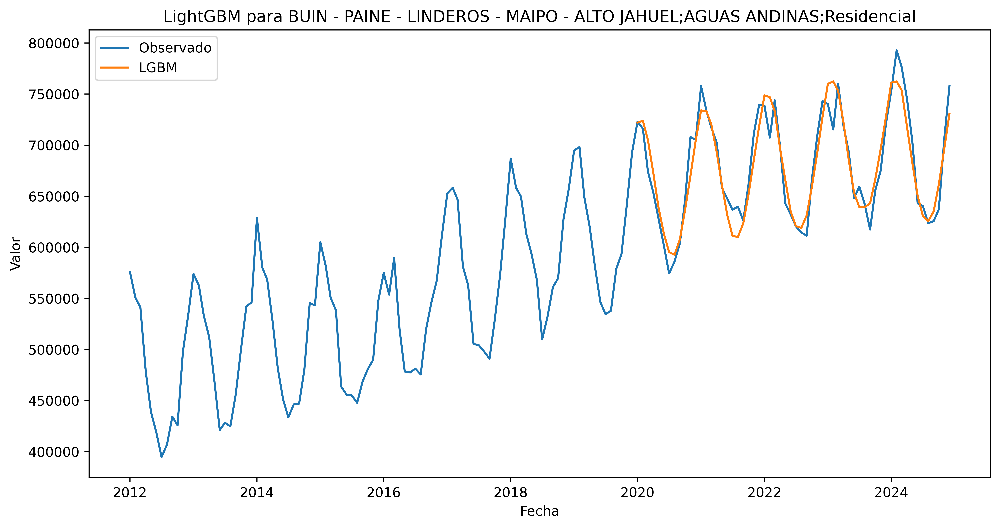

In [55]:
i = 1410
params = resultados_df["params"].loc[i].copy()
lags = int(resultados_df["lags"].loc[i])
windows_sizes = params.pop("windows_sizes")

window_features = RollingFeatures(
stats = ['mean', 'std', 'min', 'max'],
window_sizes = windows_sizes
)

forecaster = ForecasterRecursive(
    regressor        = LGBMRegressor(random_state=8520,verbose=-1 ,num_iterations= 100, **params),
    lags             = lags,
    transformer_exog = transformer_exog,
    window_features  = window_features,
    fit_kwargs       = {"categorical_feature": "auto"},
    differentiation  = d
)

# Evaluar directamente en el conjunto de test
metricas_cv, y_pred = backtesting_forecaster(
    forecaster=forecaster,
    y=y_trainval['M3 Ap'],
    exog=X_trainval[exog_features],
    cv=cv_search,
    metric=[rmse, mape, rmspe],
    show_progress= True,
    random_state=8520
)

# Evaluar directamente en el conjunto de test
forecaster.fit(y=y_trainval['M3 Ap'], exog=X_trainval)
y_pred = forecaster.predict(steps=60, exog=X_test)

mape_test = mape(y_test["M3 Ap"], y_pred)
rmse_test = rmse(y_test["M3 Ap"], y_pred)
rmspe_test = rmspe(y_test["M3 Ap"], y_pred)

print(f"MAPE: {mape_test}, RMSE: {rmse_test}, RMSPE: {rmspe_test}")

plt.figure(figsize=(12,6), dpi=600)
plt.title(f"LightGBM para {id}")
sns.lineplot(df['M3 Ap'], label="Observado")
sns.lineplot(y_pred, label = "LGBM")
plt.xlabel("Fecha")
plt.ylabel("Valor")
plt.legend()
plt.show()

In [ ]:
# Save model
save_forecaster(forecaster, file_name=f'Forecasters/forecasterlgbm_{id}.py', verbose=False)

In [41]:
params = pd.DataFrame()

for i, combi in enumerate(combination):
    forecaster = load_forecaster(file_name=f'Forecasters/forecasterlgbm_{combi}.joblib', verbose=False)
    params[combi.split(";")[-1]] = pd.DataFrame([forecaster.regressor.get_params()]).T

In [42]:
params

,Comercial,No Asociado a Inmueble,Residencial,Institucional,Industrial
boosting_type,rf,gbdt,rf,gbdt,gbdt
class_weight,None,None,None,None,None
colsample_bytree,1.0,1.0,1.0,1.0,1.0
importance_type,split,split,split,split,split
learning_rate,0.007066,0.008216,0.003292,0.003394,0.009783
max_depth,8,6,6,8,4
min_child_samples,3,10,4,14,15
min_child_weight,0.001,0.001,0.001,0.001,0.001
min_split_gain,0.0,0.0,0.0,0.0,0.0
n_estimators,6,5,3,10,3


In [13]:
forecaster = load_forecaster(file_name=f'Forecasters/forecaster_global.joblib', verbose=False)
pd.DataFrame([forecaster.regressor.get_params()]).T

,0
boosting_type,rf
class_weight,None
colsample_bytree,1.0
importance_type,split
learning_rate,0.005954
max_depth,8
min_child_samples,4
min_child_weight,0.001
min_split_gain,0.0
n_estimators,16


### Feature Importance

In [19]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(18,14), dpi=600)
axs= axs.flatten()

for i, combi in enumerate(combination):
 forecaster = load_forecaster(file_name=f'Forecasters/forecasterlgbm_{combi}.joblib', verbose=False)

 data = df_agua[df_agua['id_combinacion'] == combi]
 data = data.asfreq("MS").sort_index()

 forecaster.fit(y=data.loc[:end_validation,"M3 Ap"], exog=data.loc[:end_validation,:][exog_features])

 sns.barplot(forecaster.get_feature_importances()[:10],y="feature", x= "importance", ax=axs[i])

 axs[i].set_title(combi)

plt.show()

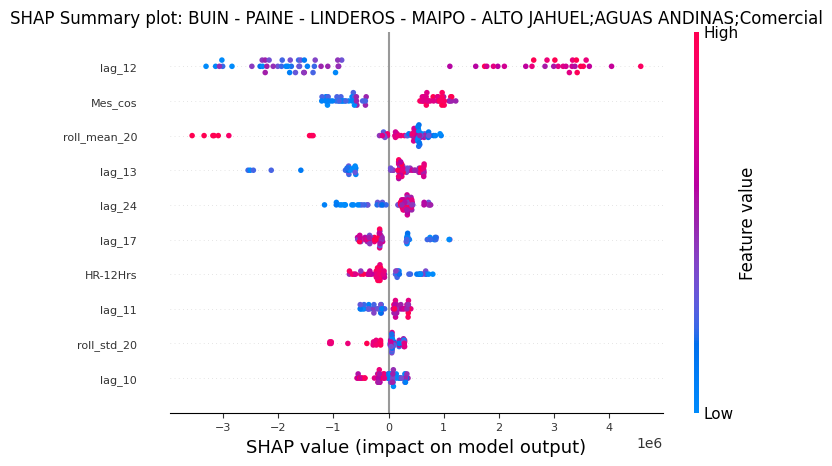

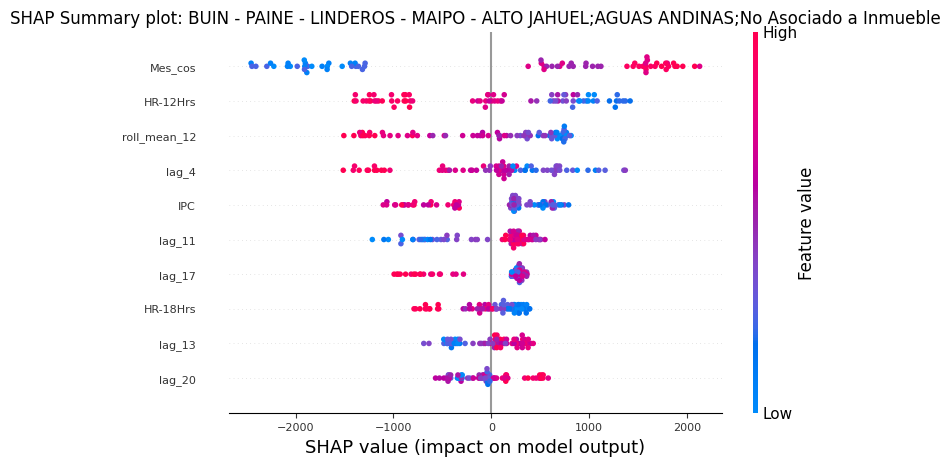

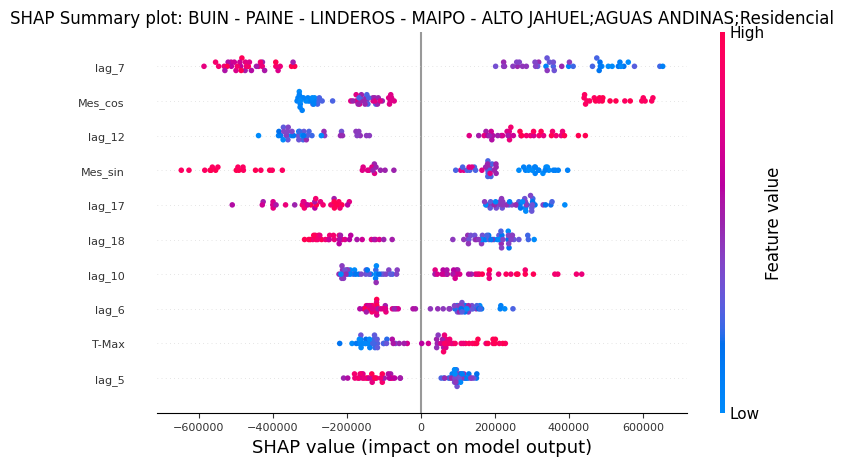

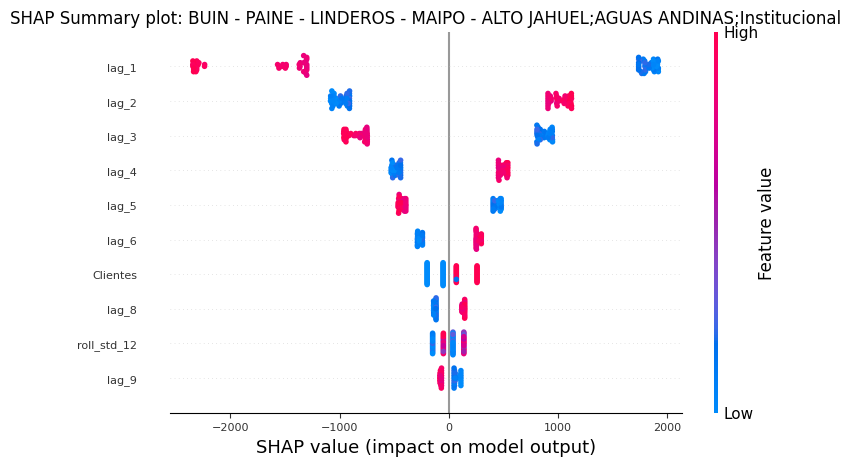

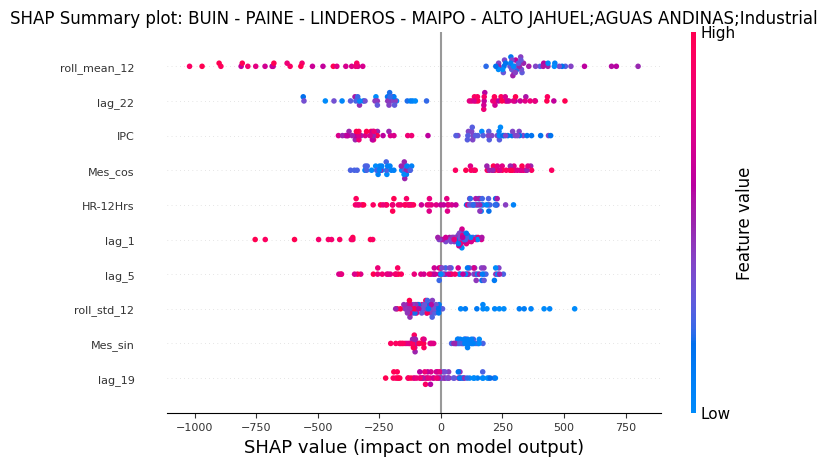

In [20]:
for i, combi in enumerate(combination):
 forecaster = load_forecaster(file_name=f'Forecasters/forecasterlgbm_{combi}.joblib', verbose=False)

 data = df_agua[df_agua['id_combinacion'] == combi]
 data = data.asfreq("MS").sort_index()

 forecaster.fit(y=data.loc[:end_validation,"M3 Ap"], exog=data.loc[:end_validation,:][exog_features])

 x_shap, y_shap = forecaster.create_train_X_y(
 y=data.loc[:end_validation,"M3 Ap"], 
 exog=data.loc[:end_validation,:][exog_features]
 )

 # Crear SHAP explainer (para modelos basados en árboles)
 # ==============================================================================
 explainer = shap.TreeExplainer(forecaster.regressor)
 shap_values = explainer.shap_values(x_shap)

 # Shap summary plot (top 10)
 # ==============================================================================
 shap.initjs()
 shap.summary_plot(shap_values, x_shap, max_display=10, show=False)
 fig, ax = plt.gcf(), plt.gca()
 ax.set_title(f"SHAP Summary plot: {combi}")
 ax.tick_params(labelsize=8)
 fig.set_size_inches(8, 4.5)
 plt.show()

In [ ]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(18,14), dpi=600)
axs= axs.flatten()

for i, combi in enumerate(combination):
 forecaster = load_forecaster(file_name=f'Forecasters/forecasterlgbm_{combi}.joblib', verbose=False)

 data = df_agua[df_agua['id_combinacion'] == combi]
 data = data.asfreq("MS").sort_index()

 forecaster.fit(y=data.loc[:end_validation,"M3 Ap"], exog=data.loc[:end_validation,:][exog_features])

 sns.barplot(forecaster.get_feature_importances()[:10],y="feature", x= "importance", ax=axs[i])

 axs[i].set_title(combi)

plt.show()

100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


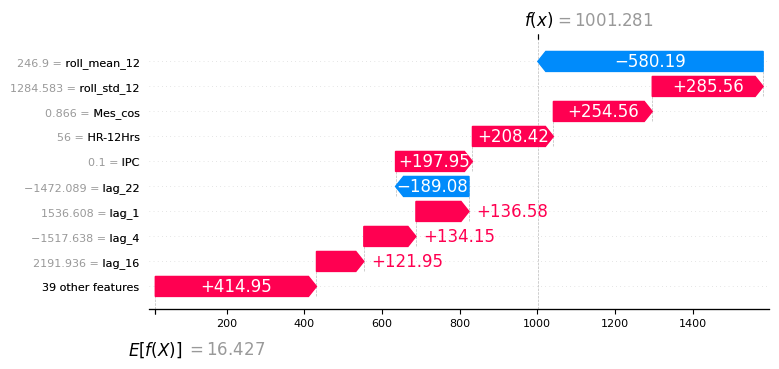

In [14]:
cv_search = TimeSeriesFold(steps=60, initial_train_size=36, differentiation=forecaster.differentiation, refit=True, fixed_train_size=False)#

# Asegurar que las columnas categóricas tengan las mismas categorías en train y validación
cat_cols = [col for col in exog_features if data[col].dtype == 'object' or str(data[col].dtype) == 'category']
for col in cat_cols:
    # Convertir a categoría si no lo es
    data[col] = data[col].astype('category')
    # Alinear categorías en todo el dataset
    all_cats = data[col].cat.categories
    data.loc[:end_validation, col] = data.loc[:end_validation, col].cat.set_categories(all_cats)
    data.loc[end_validation:, col] = data.loc[end_validation:, col].cat.set_categories(all_cats)

# Evaluar directamente en el conjunto de test
metricas_cv, predicciones = backtesting_forecaster(
    forecaster=forecaster,
    y=data.loc[:end_validation,"M3 Ap"],
    exog=data.loc[:end_validation,:][exog_features],
    cv=cv_search,
    metric=[rmse, mape, rmspe],
    show_progress= True,
    return_predictors=True,
    random_state=8520
)

# Waterfall para una predicción concreta
# ==============================================================================
predicciones = predicciones.astype(data[exog_features].dtypes) # Asegurar tipos
iloc_predicted_date = predicciones.index.get_loc('2019-01-01')
shap_values_single = explainer(predicciones.iloc[:, 2:])
shap.plots.waterfall(shap_values_single[iloc_predicted_date], show=False)
fig, ax = plt.gcf(), plt.gca()
fig.set_size_inches(8, 3.5)
ax_list = fig.axes
ax = ax_list[0]
ax.tick_params(labelsize=8)
ax.set
plt.show()

In [15]:
# Force plot para una predicción concreta
# ==============================================================================
shap.force_plot(
    base_value  = shap_values_single.base_values[iloc_predicted_date],
    shap_values = shap_values_single.values[iloc_predicted_date],
    features    = predicciones.iloc[iloc_predicted_date, 2:],
)

### Graficos

In [ ]:
df_resultados = pd.DataFrame()

fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,12), dpi=600)
axs= axs.flatten()

for i, combi in enumerate(combination):
    forecaster = load_forecaster(file_name=f'Forecasters/forecasterlgbm_{combi}.joblib', verbose=False)

    data = df_agua[df_agua['id_combinacion'] == combi]
    data = data.asfreq("MS").sort_index()

    forecaster.fit(y=data.loc[:end_validation,"M3 Ap"], exog=data.loc[:end_validation,:][exog_features])
    y_pred = forecaster.predict(steps=60, exog=data.loc[start_test:,:][exog_features])

    y_pred = y_pred.clip(lower=0)

    df_resultados = pd.concat([df_resultados, pd.DataFrame({
        'id_combinacion': combi,
        'Fecha': data.loc[start_test:,"M3 Ap"].index,
        'M3 Ap': data.loc[start_test:,"M3 Ap"].values,
        'y_pred': y_pred
    })
    ], ignore_index=True)


    mape_test = mape(data["M3 Ap"], y_pred)
    rmse_test = rmse(data["M3 Ap"], y_pred)
    rmspe_test = rmspe(data["M3 Ap"], y_pred)

    print(f"MAPE: {mape_test}, RMSE: {rmse_test}, RMSPE: {rmspe_test}")
    sns.lineplot(data=data, x="idx_fecha", y="M3 Ap", ax=axs[i], label="Test", color="#3CA6A6")
    sns.lineplot(data=y_pred,ax=axs[i], label="LightGBM", color="#FF922C")
    axs[i].set_title(combi)

MAPE: 0.0630281286022618, RMSE: 12592.294697520381, RMSPE: 0.0844573325303056
MAPE: 0.0766048492968585, RMSE: 3549.175058592146, RMSPE: 0.09356638401550596
MAPE: 0.020947019373162405, RMSE: 18011.257390298124, RMSPE: 0.026125813024225848
MAPE: 0.11680085060144707, RMSE: 511.9327843699718, RMSPE: 0.13571553095560449
MAPE: 0.17364486369395327, RMSE: 3312.4396534114667, RMSPE: 0.20237125473286707


Text(0.5, 0.98, 'Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

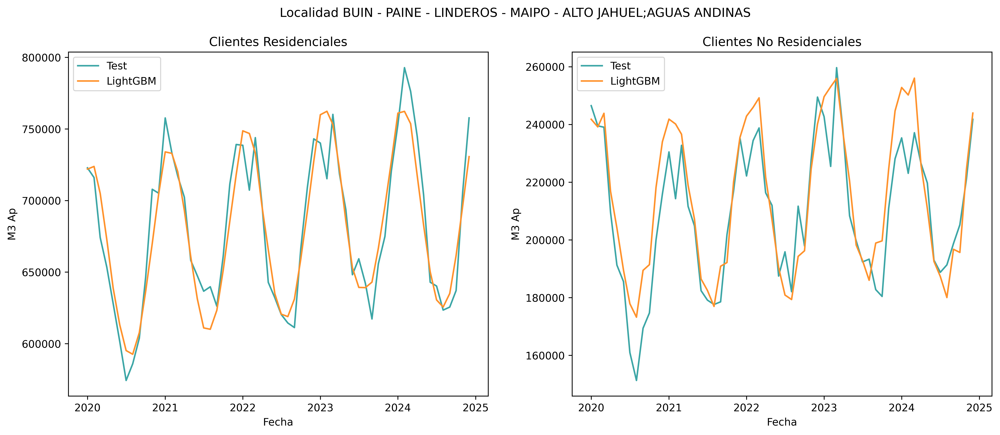

In [59]:
df_resultados["Grupo Cliente"] = df_resultados["id_combinacion"].apply(lambda x: "Residencial" if 'Residencial' in x else "No Residencial")

aux = df_resultados.groupby(by=["Fecha", "Grupo Cliente"], as_index=False)[["M3 Ap", "y_pred"]].sum()

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=600)

sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="M3 Ap", ax=axs[0], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="y_pred", ax=axs[0], label="LightGBM", color = "#FF922C")
axs[0].set_title("Clientes Residenciales")

sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="M3 Ap", ax=axs[1], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="y_pred", ax=axs[1], label="LightGBM", color = "#FF922C")
axs[1].set_title("Clientes No Residenciales")

fig.suptitle('Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

In [60]:
pd.concat(
    [
        get_error_metrics(aux[aux["Grupo Cliente"] == "Residencial"]["y_pred"], aux[aux["Grupo Cliente"] == "Residencial"]["M3 Ap"], "LightGBM", "Residencial"),
        get_error_metrics(aux[aux["Grupo Cliente"] == "No Residencial"]["y_pred"], aux[aux["Grupo Cliente"] == "No Residencial"]["M3 Ap"], "LightGBM", "No Residencial")
    ],
    axis=0
)

,Model,RMSPE,RMSE,MAPE
0,LightGBM-Residencial,0.026126,18011.257390,0.020947
0,LightGBM-No Residencial,0.060143,12072.499754,0.046150


In [61]:
df_resultados.to_csv('resultados_lgbm_om.csv', index=False)

### Predicciones Futuras

#### Preparacion datos futuros

In [39]:
df = pd.read_csv('Resultados CSV/df_agua_forecast.csv', parse_dates=["Fecha"])
df = df.sort_values(by="Fecha", ascending=True)
df = df.set_index("Fecha", drop=False).rename_axis('idx_fecha')
exog_features = [col for col in df.columns if col not in (["Nombre Corto", "Localidad","Tipo Cliente", "M3 Ap", "id_combinacion", "Fecha"])]
combination = [x for x in df["id_combinacion"].unique() if 'BUIN' in x]

In [40]:
datos_clim = pd.read_excel("Herramientas/Datos Auxiliares.xlsx", sheet_name='Datos Climaticos')
datos_econ = pd.read_excel("Herramientas/Datos Auxiliares.xlsx", sheet_name='Datos Economicos')
datos_econ["IPC"] = datos_econ["IPC"].str.replace(",", ".").astype(float)
datos_calendario = pd.read_excel("Herramientas/Datos Auxiliares.xlsx", sheet_name='Datos Calendario')
clientes_v2 = pd.read_csv('Herramientas/clientes_proyectados.csv', parse_dates=['Fecha'])

In [41]:
## Preparacion df con variables exogenas para proyectar
date_exog = pd.DataFrame(pd.date_range(start=pd.Timestamp("2012-01-01"), end=pd.Timestamp("2024-12-01"), freq='MS'), columns=["Fecha"])

date_exog = pd.merge(date_exog, datos_clim, on=["Fecha"], how='left', validate="many_to_one")

date_exog = pd.merge(date_exog, datos_econ, on=["Fecha"], how='left', validate="many_to_one")

date_exog = pd.merge(date_exog, datos_calendario[["Fecha", "Dias Laborales", "Dias No Laborales"]], on=["Fecha"], how='left', validate="many_to_one")

date_exog = date_exog.set_index("Fecha", drop=False).rename_axis('idx_fecha').asfreq("MS").sort_index()

In [42]:
end_validation = '2019-12-01'
start_test = '2020-01-01'
end_test = '2024-12-01'

In [78]:
def search_space(trial):
    return {
        'boosting_type': trial.suggest_categorical('boosting_type', ['gbdt', 'dart']),
        'lags': trial.suggest_int('lags', 2, 16),
        'n_estimators': trial.suggest_int('n_estimators', 2, 16),
        'max_bin': trial.suggest_int('max_bin', 2, 16),
        'max_depth': trial.suggest_int('max_depth', 6, 16),
        'num_leaves' : trial.suggest_int('num_leaves', 2,32, step=1),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 16),
        'min_child_samples': trial.suggest_int('min_child_samples', 2, 16),
        'min_data_in_bin': trial.suggest_int('min_data_in_bin', 3, 16),
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.1),
        'feature_fraction': trial.suggest_float('feature_fraction', 0.05, 0.8, step=0.05),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.1, 0.9, step=0.1),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.1, 0.9, step=0.1),
    }

In [79]:
combi = combination[4]
df_ml = df[df["id_combinacion"] == combi].set_index("Fecha", drop=False).rename_axis('idx_fecha').asfreq("MS").sort_index()
print(combi)

BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial


In [88]:
var = "Clientes"
# Diferenciacion
d = 0
i = 0
aux = df_ml[var]
while check_stationarity(aux) > 0.05 and i < 3:
    aux = aux.diff().dropna()
    d += 1
    i += 1

d = d if d > 0 else None
print(f"Diferenciación necesaria: {d}")
window_features = RollingFeatures(
stats = ['mean', 'std', 'min', 'max'],
window_sizes = 12
)

# Configurar validación cruzada dentro del train_val
cv_search = TimeSeriesFold(steps=60, initial_train_size=36, differentiation=d, refit=True, fixed_train_size=False)#

# Lista para guardar resultados extendidos
resultados = []

# Búsqueda manual de hiperparámetros con evaluación real
def objective(trial):
    # Obtener parámetros del espacio de búsqueda
    params = search_space(trial)
    lags = params.pop('lags')

    # Crear forecaster
    forecaster = ForecasterRecursive(
        regressor=LGBMRegressor(random_state=8520,verbose=-1,**params),
        lags=lags,
        # window_features  = window_features,
        differentiation  = d
    )

    # Backtesting dentro del conjunto de entrenamiento + validación
    metricas_cv, _ = backtesting_forecaster(
        forecaster=forecaster,
        y=df_ml.loc[:end_validation,:][var],
        cv=cv_search,
        metric=[rmse, mape, rmspe],
        show_progress= False,
        random_state=8520
    )

    forecaster.fit(y=df_ml.loc[:end_validation,:][var])
    # Evaluar directamente en el conjunto de test
    y_pred = forecaster.predict(steps=60)

    mape_test = mape(df_ml.loc[start_test:,][var], y_pred)
    rmse_test = rmse(df_ml.loc[start_test:,][var], y_pred)
    rmspe_test = rmspe(df_ml.loc[start_test:,][var], y_pred)

    # Guardar resultados extendidos
    resultados.append({
        'params': deepcopy(params),
        'lags': lags,
        'rmse_cv': metricas_cv['rmse'].values[0],
        'mape_cv': metricas_cv['mape'].values[0],
        'rmspe_cv': metricas_cv['rmspe'].values[0],
        'mape_test': mape_test,
        'rmse_test': rmse_test,
        'rmspe_test': rmspe_test
    })

    return metricas_cv['rmse'].values[0]  # objetivo para minimizar en la búsqueda

sampler = optuna.samplers.TPESampler(seed=8520)
study = create_study(direction='minimize', sampler=sampler)

study.optimize(objective, n_trials=1000, show_progress_bar=True, gc_after_trial=True)

Diferenciación necesaria: 1


Best trial: 982. Best value: 1.97034: 100%|██████████| 1000/1000 [05:47<00:00,  2.88it/s]


In [89]:
# Convertir resultados a DataFrame
resultados_df = pd.DataFrame(resultados)

# Calcular ponderaciones usando normalización min-max (minimizar)
for metric in ['mape_test', 'rmse_test', 'rmspe_test', 'mape_cv', 'rmse_cv', 'rmspe_cv']:
    min_val = resultados_df[metric].min()
    max_val = resultados_df[metric].max()
    resultados_df[f'{metric}_norm'] = (resultados_df[metric] - min_val) / (max_val - min_val)

resultados_df["Ponderacion_test"] = resultados_df[['mape_test_norm', 'rmse_test_norm', 'rmspe_test_norm']].mean(axis=1)
resultados_df["Ponderacion_cv"] = resultados_df[['mape_cv_norm', 'rmse_cv_norm', 'rmspe_cv_norm']].mean(axis=1)
resultados_df["Ponderacion"] = (resultados_df["Ponderacion_cv"] + resultados_df["Ponderacion_test"]) / 2 * 100

resultados_df.sort_values(by="Ponderacion", ascending=True)

,params,lags,rmse_cv,mape_cv,rmspe_cv,mape_test,rmse_test,rmspe_test,mape_test_norm,rmse_test_norm,rmspe_test_norm,mape_cv_norm,rmse_cv_norm,rmspe_cv_norm,Ponderacion_test,Ponderacion_cv,Ponderacion
42,"{'boosting_type': 'gbdt', 'n_estimators': 16, ...",4,2.490433,0.030774,0.035475,0.015376,1.460457,0.022045,0.000000,0.000000,0.000000,0.091807,0.073583,0.062707,0.000000,0.076032,3.801620
85,"{'boosting_type': 'gbdt', 'n_estimators': 11, ...",2,2.051926,0.025559,0.030529,0.025876,2.231692,0.033163,0.091366,0.082683,0.078964,0.031284,0.011543,0.017679,0.084338,0.020169,5.225332
45,"{'boosting_type': 'dart', 'n_estimators': 16, ...",2,2.049714,0.025530,0.030485,0.028486,2.458069,0.036567,0.114082,0.106953,0.103140,0.030952,0.011230,0.017283,0.108059,0.019822,6.394011
24,"{'boosting_type': 'gbdt', 'n_estimators': 11, ...",8,2.292124,0.028123,0.034703,0.027849,2.327238,0.034583,0.108532,0.092927,0.089047,0.061038,0.045527,0.055679,0.096835,0.054081,7.545819
33,"{'boosting_type': 'gbdt', 'n_estimators': 15, ...",4,2.177916,0.027033,0.032776,0.030379,2.575400,0.038334,0.130553,0.119532,0.115688,0.048393,0.029368,0.038134,0.121924,0.038632,8.027801
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9,"{'boosting_type': 'dart', 'n_estimators': 4, '...",16,5.479341,0.071796,0.080486,0.105710,8.515242,0.128427,0.786065,0.756337,0.755566,0.567829,0.496453,0.472468,0.765990,0.512250,63.911971
83,"{'boosting_type': 'gbdt', 'n_estimators': 11, ...",16,4.336384,0.055932,0.063140,0.127065,10.524204,0.158842,0.971889,0.971716,0.971583,0.383744,0.334748,0.314556,0.971730,0.344349,65.803943
343,"{'boosting_type': 'gbdt', 'n_estimators': 7, '...",16,4.355228,0.056192,0.063430,0.130296,10.788023,0.162843,1.000000,1.000000,1.000000,0.386754,0.337414,0.317201,1.000000,0.347123,67.356141
651,"{'boosting_type': 'gbdt', 'n_estimators': 6, '...",16,5.705642,0.074830,0.083934,0.112913,9.270426,0.139847,0.848742,0.837300,0.836671,0.603036,0.528470,0.503863,0.840904,0.545123,69.301356


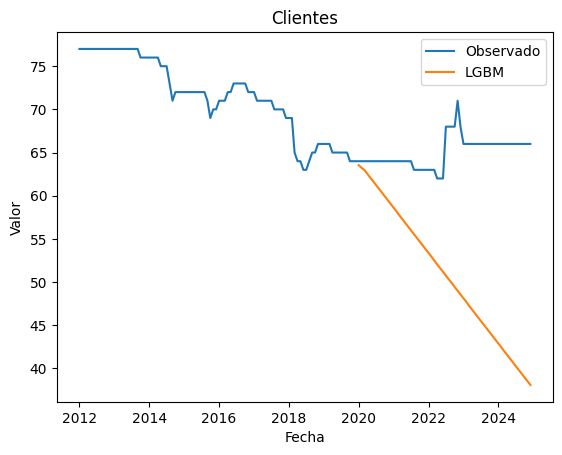

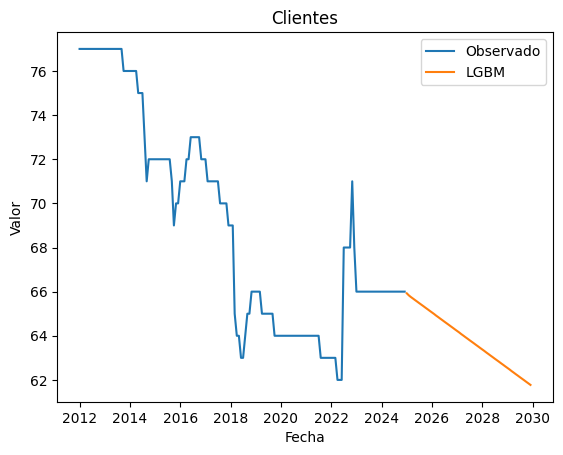

In [90]:
i = 42
params = resultados_df["params"].loc[i]
lags = int(resultados_df["lags"].loc[i])
# Crear forecaster
forecaster = ForecasterRecursive(
    regressor=LGBMRegressor(random_state=8520,verbose=-1, **params),
    lags=lags,
    window_features  = window_features,
    differentiation  = d
)

# Backtesting dentro del conjunto de entrenamiento + validación
metricas_cv, _ = backtesting_forecaster(
    forecaster=forecaster,
    y=df_ml.loc[:end_validation,:][var],
    cv=cv_search,
    metric=[rmse, mape, rmspe],
    show_progress= False,
    random_state=8520
)

forecaster.fit(y=df_ml.loc[:end_validation,:][var])
# Evaluar directamente en el conjunto de test
y_pred = forecaster.predict(steps=60)
plt.figure()
plt.title(var)
sns.lineplot(df_ml[var], label="Observado")
sns.lineplot(y_pred, label = "LGBM")
plt.xlabel("Fecha")
plt.ylabel("Valor")
plt.legend()
plt.show()

forecaster.fit(y=df_ml[var])
# Evaluar directamente en el conjunto de test
y_pred = forecaster.predict(steps=60)

plt.figure()
plt.title(var)
sns.lineplot(df_ml[var], label="Observado")
sns.lineplot(y_pred, label = "LGBM")
plt.xlabel("Fecha")
plt.ylabel("Valor")
plt.legend()
plt.show()

In [ ]:
# poblacion_v3 = pd.read_csv('Herramientas/Poblacion_proyectados_V3.csv', sep=';').drop(columns=['Año', 'Mes'])
# poblacion_v3["Fecha"] = pd.to_datetime(poblacion_v3["Fecha"].str.replace("/", '-'), format="%d-%m-%Y")

# localidades_df = pd.read_excel("Herramientas/Datos Auxiliares.xlsx", sheet_name='Localidades')
# # Expand poblacion_v3 so each row is repeated for every Localidad associated with its Comuna
# poblacion_v3 = pd.merge(localidades_df,poblacion_v3[poblacion_v3["Fecha"] < '2030-01-01'],  left_on="Comuna", right_on="Nombre Comuna", how="left").groupby(["Fecha", "Localidad"], as_index=False)["Poblacion"].sum()

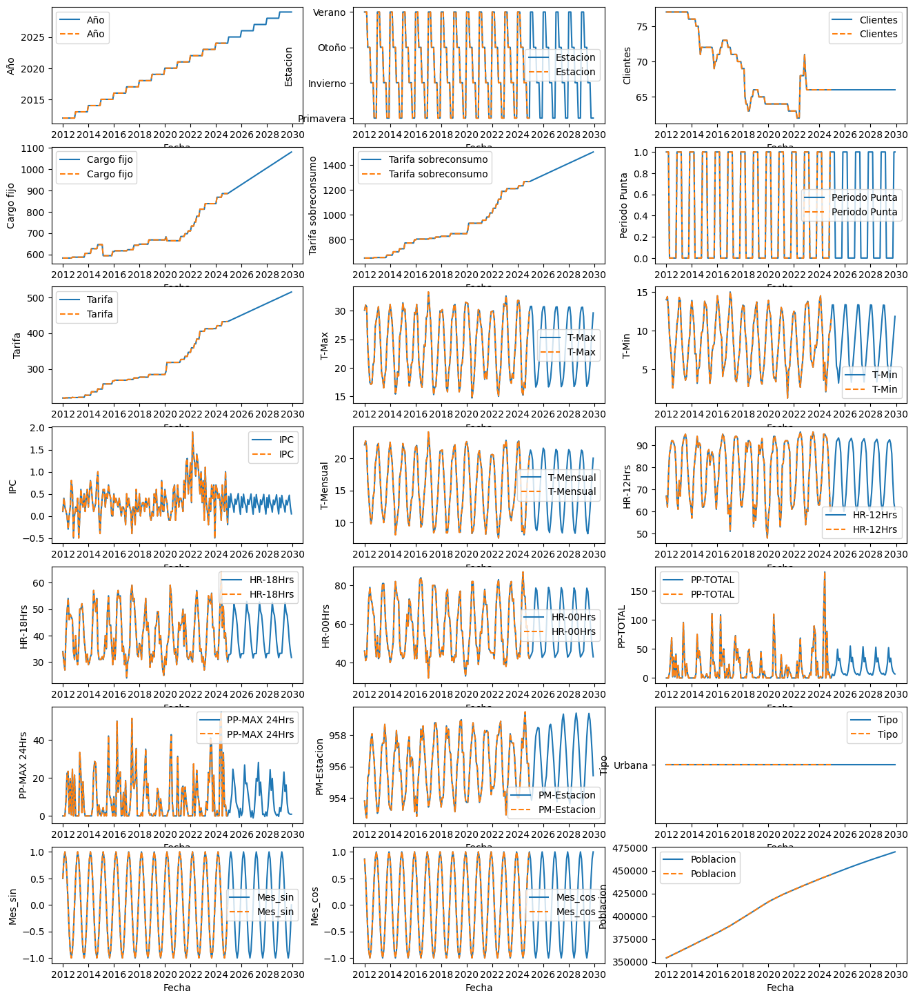

In [ ]:
df_expanded = pd.read_csv(filepath_or_buffer="Resultados CSV/df_expanded.csv", parse_dates=["Fecha"]).set_index('Fecha', drop=False).rename_axis('idx_fecha')
# df_expanded = pd.merge(df_expanded.drop(columns="Poblacion"), poblacion_v3, on=['Fecha', 'Localidad'], how='left')
# df_expanded = pd.merge(df_expanded, clientes_v2[['Fecha', 'id_combinacion', 'Clientes']], on=['Fecha', 'id_combinacion'], how='left')
# df_expanded["Clientes"] = df_expanded["Clientes_x"].replace(np.nan, 0).astype(int) + df_expanded["Clientes_y"].replace(np.nan, 0).astype(int)
# df_expanded = df_expanded.drop(columns=["Clientes_x", "Clientes_y"])

mask = (df_expanded["Fecha"] < '2025-01-01') & (df_expanded["id_combinacion"] == combi)
# No assignment needed if you want to keep original values, but if you want to set others to NaN:
df_expanded.loc[~mask & (df_expanded["id_combinacion"] == combi), "Clientes"] = np.nan
# df_expanded.set_index("Fecha", inplace=True, drop=False)
# df_expanded.update(pd.DataFrame(y_pred).rename(columns={'pred':var}))

# df_expanded.loc[(df_expanded["Fecha"] >= pd.Timestamp('2025-01-01')), "Clientes"] = np.nan
# df_expanded.update(pd.DataFrame(y_pred).rename(columns={'pred':var}))

fig, axs = plt.subplots(nrows=7, ncols=3, figsize=(16,18))
axs = axs.flatten()
for i, col in enumerate(iterable=exog_features):
    sns.lineplot(df_expanded[df_expanded["id_combinacion"] == combi], x="Fecha", y=col, ax=axs[i], label=col, )
    sns.lineplot(df_agua[df_agua["id_combinacion"] == combi], x="Fecha", y=col, ax=axs[i], label=col,linestyle="--")

In [93]:
df_expanded.to_csv("Resultados CSV/df_expanded.csv", index=False)

#### Proyeccion

In [13]:
df_expanded = pd.read_csv(filepath_or_buffer="Resultados CSV/df_expanded.csv", parse_dates=["Fecha"]).set_index('Fecha', drop=False).rename_axis('idx_fecha')

In [14]:
proyeccion_df = pd.DataFrame()

fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,12), dpi=600)
axs= axs.flatten()

for i, combi in enumerate(combination):
    df_ml = df_agua[df_agua["id_combinacion"] == combi].asfreq("MS").sort_index()
    df_aux = df_expanded[df_expanded["id_combinacion"]==combi].asfreq("MS").sort_index()

    end_validation = '2019-12-01'
    start_test = '2020-01-01'
    end_test = '2024-12-01'

    y_trainval = df_ml.loc[:end_validation,:]
    y_test     = df_ml.loc[start_test:,]  # Últimos 60 datos

    # Variables exógenas si las usas
    X_trainval = y_trainval[exog_features]
    X_test     = y_test[exog_features]

    forecaster = load_forecaster(file_name=f'Forecasters/forecasterlgbm_{combi}.joblib', verbose=False)
    forecaster.fit(y=df_ml['M3 Ap'], exog=df_ml[exog_features])
    # Evaluar directamente en el conjunto de test
    y_pred = forecaster.predict(steps=60, exog=df_aux.loc['2025-01-01':,:][exog_features])

    proyeccion_df = pd.concat([proyeccion_df, pd.DataFrame({
        'id_combinacion': combi,
        'Fecha': y_pred.index,
        'y_pred': y_pred
    })
    ], ignore_index=True)

    
    axs[i].set_title(combi)
    sns.lineplot(df_ml['M3 Ap'], label="Observado", ax=axs[i])
    sns.lineplot(y_pred, label = "LGBM", ax=axs[i])

In [17]:
proyeccion_df
proyeccion_df.to_csv('Forecasters/proyeccion_lgbm_om.csv', index=False)

In [16]:
df_lgbm_on = pd.concat([df_resultados, proyeccion_df], axis=0, ignore_index=True)
df_lgbm_on["Grupo Cliente"] = df_lgbm_on["id_combinacion"].apply(lambda x: "Residencial" if 'Residencial' in x else "No Residencial")
df_lgbm_on.to_csv("Forecasters/lgbm_2020_2023.csv", index=False)
df_lgbm_on

NameError: name 'df_resultados' is not defined

## Global Model

### Preprocesamiento

In [21]:
from skforecast.preprocessing import series_long_to_dict, exog_long_to_dict
from skforecast.recursive import ForecasterRecursiveMultiSeries
from skforecast.model_selection import backtesting_forecaster_multiseries

In [22]:
df = pd.read_csv('Resultados CSV/df_agua_forecast.csv', parse_dates=["Fecha"])
df = df.sort_values(by="Fecha", ascending=True)
df = df.set_index("Fecha", drop=False).rename_axis('idx_fecha')
exog_features = [col for col in df.columns if col not in (["Nombre Corto", "Localidad", "M3 Ap", "id_combinacion", "Fecha"])]
combination = [x for x in df["id_combinacion"].unique() if 'BUIN' in x]
df = df[df["id_combinacion"].isin(combination)]

In [23]:
# Transformar las series y las variables exógenas a diccionarios
# ==============================================================================
series_dict = series_long_to_dict(
    data      = df.reset_index(drop=True),
    series_id = 'id_combinacion',
    index     = "Fecha",
    values    = 'M3 Ap',
    freq      = 'MS',
    suppress_warnings=True
)

exog_dict = exog_long_to_dict(
    data      = df[exog_features + ['Fecha', 'id_combinacion']].reset_index(drop=True),
    series_id = 'id_combinacion',
    index     = 'Fecha',
    freq      = 'MS'
)

In [24]:
# Partiticón de los datos en entrenamiento, validación y test
# ==============================================================================
data = df.sort_index()
end_train = '2017-12-01'
end_validation = '2019-12-01'
start_future = '2020-01-01'
series_dict_train = {k: v.loc[: end_train,] for k, v in series_dict.items()}
series_dict_valid = {k: v.loc[end_train: end_validation,] for k, v in series_dict.items()}
series_dict_test = {k: v.loc[end_validation:,] for k, v in series_dict.items()}
exog_dict_train = {k: v.loc[: end_train,] for k, v in exog_dict.items()}
exog_dict_valid = {k: v.loc[end_train: end_validation,] for k, v in exog_dict.items()}
exog_dict_test = {k: v.loc[end_validation:,] for k, v in exog_dict.items()}


In [25]:
diff_dict = {}
diff_dict['_unknown_level'] = None
for combi in combination:
    # Diferenciacion
    d = 0
    i = 0
    aux = df[df["id_combinacion"] == combi]['M3 Ap']
    while check_stationarity(aux) > 0.05 and i < 3:
        aux = aux.diff().dropna()
        d += 1
        i += 1
    diff_dict[combi] = d if d > 0 else None

### Modelo

In [17]:
# Configurar validación cruzada dentro del train_val
cv_search = TimeSeriesFold(steps=60, initial_train_size=36, refit=True, fixed_train_size=False, differentiation=1)

In [41]:
# -------------------------------------------------------------------
# 1. Definir espacio de búsqueda de hiperparámetros (sin cambios)
# -------------------------------------------------------------------
def search_space(trial):
    return {
        'boosting_type': trial.suggest_categorical('boosting_type', ['dart','gbdt', 'rf']),
        'lags': trial.suggest_int('lags', 2, 32),
        'n_estimators': trial.suggest_int('n_estimators', 2, 16),
        'max_bin': trial.suggest_int('max_bin', 2, 35),
        'max_depth': trial.suggest_int('max_depth', 2, 12),
        'num_leaves' : trial.suggest_int('num_leaves', 2, 24, step=1),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 2, 36),
        'min_child_samples': trial.suggest_int('min_child_samples', 2, 36),
        'min_data_in_bin': trial.suggest_int('min_data_in_bin', 3, 36),
        'learning_rate': trial.suggest_float('learning_rate', 0.0001, 0.01),
        'feature_fraction': trial.suggest_float('feature_fraction', 0.05, 0.8, step=0.05),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.1, 0.9, step=0.1),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.1, 0.9, step=0.1),
        'linear_tree': trial.suggest_categorical('linear_tree', [True, False]),
        'windows_sizes':trial.suggest_int("windows_sizes", 0, 24, step=2),
        'num_iterations':trial.suggest_int("num_iterations", 10, 500, step=10)
    }


In [43]:
# -------------------------------------------------------------------
# 2. Ciclo de evaluación: búsqueda + evaluación inmediata en test
# -------------------------------------------------------------------

# Lista para guardar resultados extendidos
resultados = []

# Búsqueda manual de hiperparámetros con evaluación real
def objective(trial):
    # Obtener parámetros del espacio de búsqueda
    params = search_space(trial)
    copy_params = search_space(trial)
    lags = params.pop('lags')
    windows_sizes = params.pop('windows_sizes')
    num_iterations = params.pop('num_iterations')

    window_features = RollingFeatures(
    stats = ['mean', 'std', 'min', 'max'],
    window_sizes = windows_sizes
    )

    # Crear forecaster
    forecaster = ForecasterRecursiveMultiSeries(
        regressor=LGBMRegressor(random_state=8520,verbose=-1 ,num_iterations= num_iterations, **params),
        lags=lags,
        transformer_exog = transformer_exog,
        window_features  = window_features if windows_sizes > 0 else None,
        fit_kwargs       = {"categorical_feature": "auto"},
        differentiation  = diff_dict
    )

    # Backtesting dentro del conjunto de entrenamiento + validación
    metricas_cv, predictions  = backtesting_forecaster_multiseries(
        forecaster            = forecaster,
        series                = {k: v.loc[:,] for k, v in series_dict.items()},
        exog                  = {k: v.loc[:, exog_features] for k, v in exog_dict.items()},
        cv                    = cv_search,
        metric                = [rmse,rmspe, mape],
        show_progress         = False,
        random_state          = 8520
    )

    # Evaluar directamente en el conjunto de test
    forecaster.fit(
        series = {k: v.loc[:end_validation,] for k, v in series_dict.items()},
        exog   = {k: v.loc[:end_validation, exog_features] for k, v in exog_dict.items()}
    )

    predictions_lgbm_mg = forecaster.predict(steps=60, exog = {k: v.loc['2020-01-01':, exog_features] for k, v in exog_dict.items()})

    prom_mape = []
    prom_rmse = []
    prom_rmspe = []

    for i, combi in enumerate(combination):
        data = df_agua[df_agua['id_combinacion'] == combi]
        data = data.loc[start_test:,"M3 Ap"].asfreq("MS").sort_index()

        y_pred=predictions_lgbm_mg[predictions_lgbm_mg["level"] == combi]["pred"]

        prom_mape.append(mape(data, y_pred))
        prom_rmse.append(rmse(data, y_pred))
        prom_rmspe.append(rmspe(data, y_pred))

    # Guardar resultados extendidos
    resultados.append({
        'params': copy_params,
        'lags': lags,
        'rmse_cv': metricas_cv['rmse'].values[0],
        'mape_cv': metricas_cv['mape'].values[0],
        'rmspe_cv': metricas_cv['rmspe'].values[0],
        'mape_test': np.mean(prom_mape),
        'rmse_test': np.mean(prom_rmse),
        'rmspe_test': np.mean(prom_rmspe)
    })

    return metricas_cv['rmspe'].values[0]  # objetivo para minimizar en la búsqueda

# Búsqueda bayesiana (puedes usar optuna directamente si prefieres)
sampler = optuna.samplers.TPESampler(seed=8520)
study = create_study(direction='minimize', sampler=sampler)

study.optimize(objective, n_trials=5000, show_progress_bar=True, gc_after_trial=True, catch=ValueError)

  0%|          | 0/5000 [00:00<?, ?it/s]

Best trial: 702. Best value: 0.0679961:  27%|██▋       | 1356/5000 [19:47<1:12:13,  1.19s/it]

[W 2025-07-30 12:51:15,844] Trial 1356 failed with parameters: {'boosting_type': 'dart', 'lags': 4, 'n_estimators': 3, 'max_bin': 21, 'max_depth': 6, 'num_leaves': 16, 'min_data_in_leaf': 12, 'min_child_samples': 8, 'min_data_in_bin': 24, 'learning_rate': 0.0016979912573090524, 'feature_fraction': 0.7500000000000001, 'reg_alpha': 0.9, 'reg_lambda': 0.8, 'linear_tree': True, 'windows_sizes': 22, 'num_iterations': 260} because of the following error: ValueError('could not broadcast input array from shape (56,) into shape (60,)').
Traceback (most recent call last):
  File "c:\Program Files\Python312\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\ilagreze\AppData\Local\Temp\ipykernel_13924\1073201569.py", line 33, in objective
    metricas_cv, predictions  = backtesting_forecaster_multiseries(
                                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Program File

Best trial: 2112. Best value: 0.0644087:  56%|█████▌    | 2809/5000 [47:47<44:48,  1.23s/it]  

[W 2025-07-30 13:19:15,261] Trial 2809 failed with parameters: {'boosting_type': 'dart', 'lags': 20, 'n_estimators': 8, 'max_bin': 30, 'max_depth': 5, 'num_leaves': 14, 'min_data_in_leaf': 11, 'min_child_samples': 16, 'min_data_in_bin': 22, 'learning_rate': 0.002754557906056899, 'feature_fraction': 0.7000000000000001, 'reg_alpha': 0.9, 'reg_lambda': 0.4, 'linear_tree': True, 'windows_sizes': 22, 'num_iterations': 280} because of the following error: ValueError('could not broadcast input array from shape (57,) into shape (60,)').
Traceback (most recent call last):
  File "c:\Program Files\Python312\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\ilagreze\AppData\Local\Temp\ipykernel_13924\1073201569.py", line 33, in objective
    metricas_cv, predictions  = backtesting_forecaster_multiseries(
                                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Program Fil

Best trial: 2963. Best value: 0.063769:  65%|██████▌   | 3273/5000 [57:52<42:46,  1.49s/it] 

[W 2025-07-30 13:29:20,731] Trial 3273 failed with parameters: {'boosting_type': 'dart', 'lags': 18, 'n_estimators': 4, 'max_bin': 28, 'max_depth': 5, 'num_leaves': 12, 'min_data_in_leaf': 10, 'min_child_samples': 16, 'min_data_in_bin': 23, 'learning_rate': 0.001972644933389642, 'feature_fraction': 0.7000000000000001, 'reg_alpha': 0.8, 'reg_lambda': 0.6, 'linear_tree': True, 'windows_sizes': 22, 'num_iterations': 340} because of the following error: ValueError('could not broadcast input array from shape (57,) into shape (60,)').
Traceback (most recent call last):
  File "c:\Program Files\Python312\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\ilagreze\AppData\Local\Temp\ipykernel_13924\1073201569.py", line 33, in objective
    metricas_cv, predictions  = backtesting_forecaster_multiseries(
                                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Program Fil

Best trial: 3433. Best value: 0.0637447:  82%|████████▏ | 4081/5000 [1:17:57<22:27,  1.47s/it]

[W 2025-07-30 13:49:25,807] Trial 4081 failed with parameters: {'boosting_type': 'dart', 'lags': 19, 'n_estimators': 4, 'max_bin': 33, 'max_depth': 4, 'num_leaves': 14, 'min_data_in_leaf': 12, 'min_child_samples': 20, 'min_data_in_bin': 25, 'learning_rate': 0.001842392285162225, 'feature_fraction': 0.7000000000000001, 'reg_alpha': 0.9, 'reg_lambda': 0.5, 'linear_tree': True, 'windows_sizes': 22, 'num_iterations': 250} because of the following error: ValueError('could not broadcast input array from shape (57,) into shape (60,)').
Traceback (most recent call last):
  File "c:\Program Files\Python312\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\ilagreze\AppData\Local\Temp\ipykernel_13924\1073201569.py", line 33, in objective
    metricas_cv, predictions  = backtesting_forecaster_multiseries(
                                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Program Fil

Best trial: 3433. Best value: 0.0637447: 100%|██████████| 5000/5000 [1:40:37<00:00,  1.21s/it]


In [44]:
# Convertir resultados a DataFrame
resultados_df = pd.DataFrame(resultados)

# Calcular ponderaciones usando normalización min-max (minimizar)
for metric in ['mape_test', 'rmse_test', 'rmspe_test', 'mape_cv', 'rmse_cv', 'rmspe_cv']:
    min_val = resultados_df[metric].min()
    max_val = resultados_df[metric].max()
    resultados_df[f'{metric}_norm'] = (resultados_df[metric] - min_val) / (max_val - min_val)

resultados_df["Ponderacion_test"] = resultados_df[['mape_test_norm', 'rmse_test_norm', 'rmspe_test_norm']].mean(axis=1)
resultados_df["Ponderacion_cv"] = resultados_df[['mape_cv_norm', 'rmse_cv_norm', 'rmspe_cv_norm']].mean(axis=1)
resultados_df["Ponderacion"] = (resultados_df["Ponderacion_cv"] + resultados_df["Ponderacion_test"]) / 2 * 100

resultados_df.sort_values(by="Ponderacion", ascending=True)

,params,lags,rmse_cv,mape_cv,rmspe_cv,mape_test,rmse_test,rmspe_test,mape_test_norm,rmse_test_norm,rmspe_test_norm,mape_cv_norm,rmse_cv_norm,rmspe_cv_norm,Ponderacion_test,Ponderacion_cv,Ponderacion
4713,"{'boosting_type': 'rf', 'lags': 28, 'n_estimat...",28,2.006274e+04,1.120952e-01,1.413313e-01,1.491455e-01,1.496844e+04,1.735908e-01,0.000000e+00,2.415206e-146,0.000000e+00,2.115271e-169,0.0,0.0,8.050687e-147,7.050904e-170,4.025343e-145
2590,"{'boosting_type': 'rf', 'lags': 30, 'n_estimat...",30,2.171123e+04,1.193059e-01,1.539313e-01,1.530695e-01,1.345396e+04,1.804156e-01,3.593217e-146,1.682813e-146,8.102327e-147,2.362392e-169,0.0,0.0,2.028754e-146,7.874641e-170,1.014377e-144
2093,"{'boosting_type': 'rf', 'lags': 26, 'n_estimat...",26,1.570602e+04,8.696030e-02,1.073163e-01,1.536874e-01,1.614491e+04,1.804450e-01,4.159056e-146,2.984139e-146,8.137157e-147,1.253868e-169,0.0,0.0,2.652303e-146,4.179560e-170,1.326152e-144
3898,"{'boosting_type': 'rf', 'lags': 26, 'n_estimat...",26,1.506789e+04,8.149492e-02,1.050321e-01,1.561606e-01,1.714024e+04,1.844398e-01,6.423785e-146,3.465476e-146,1.287969e-146,1.066563e-169,0.0,0.0,3.725743e-146,3.555208e-170,1.862872e-144
4975,"{'boosting_type': 'rf', 'lags': 27, 'n_estimat...",27,1.970243e+04,1.157245e-01,1.340037e-01,1.578401e-01,1.455695e+04,1.860066e-01,7.961752e-146,2.216213e-146,1.473984e-146,2.239652e-169,0.0,0.0,3.883983e-146,7.465506e-170,1.941992e-144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2610,"{'boosting_type': 'dart', 'lags': 28, 'n_estim...",28,4.572455e+98,2.457829e+92,2.632717e+93,3.108812e+125,1.125132e+131,2.394127e+126,2.846791e-18,5.441068e-19,2.842268e-18,8.423286e-76,0.0,0.0,2.077722e-18,2.807762e-76,1.038861e-16
3271,"{'boosting_type': 'dart', 'lags': 27, 'n_estim...",27,inf,4.501757e+151,4.917015e+152,3.817347e+49,9.197897e+54,2.037116e+50,3.495608e-94,4.448044e-95,2.418431e-94,1.542808e-16,NaN,0.0,2.119614e-94,7.714042e-17,3.857021e-15
2568,"{'boosting_type': 'dart', 'lags': 27, 'n_estim...",27,inf,1.745857e+156,inf,1.517142e+31,6.939535e+37,9.241986e+31,1.389273e-112,3.355914e-112,1.097193e-112,5.983271e-12,NaN,NaN,1.947460e-112,5.983271e-12,2.991635e-10
4320,"{'boosting_type': 'dart', 'lags': 27, 'n_estim...",27,inf,2.917898e+167,inf,8.992117e+27,7.501937e+33,5.462769e+28,8.234232e-116,3.627888e-116,6.485309e-116,1.000000e+00,NaN,NaN,6.115810e-116,1.000000e+00,5.000000e+01


In [49]:
i = 616
params = resultados_df["params"].loc[i].copy()
lags = int(resultados_df["lags"].loc[i])
windows_sizes = params.pop("windows_sizes")
num_iterations = params.pop("num_iterations")

window_features = RollingFeatures(
    stats=['mean', 'std', 'min', 'max'],
    window_sizes=windows_sizes
)
forecaster = ForecasterRecursiveMultiSeries(
    regressor=LGBMRegressor(random_state=8520, verbose=-1, num_iterations=num_iterations, **params),
    lags=lags,
    transformer_exog=transformer_exog,
    window_features=window_features,
    fit_kwargs={"categorical_feature": "auto"},
    differentiation=diff_dict
)

# Backtesting dentro del conjunto de entrenamiento + validación
metricas_cv, predictions  = backtesting_forecaster_multiseries(
    forecaster            = forecaster,
    series                = {k: v.loc[:,] for k, v in series_dict.items()},
    exog                  = {k: v.loc[:, exog_features] for k, v in exog_dict.items()},
    cv                    = cv_search,
    metric                = [rmse,rmspe, mape],
    show_progress= False,
    random_state=8520
)

# Evaluar directamente en el conjunto de test
forecaster.fit(
    series = {k: v.loc[:end_validation,] for k, v in series_dict.items()},
    exog   = {k: v.loc[:end_validation, exog_features] for k, v in exog_dict.items()}
)

predictions_lgbm_mg = forecaster.predict(steps=60, 
                                        exog = {k: v.loc['2020-01-01':, exog_features] for k, v in exog_dict.items()})


fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,12), dpi=600)
axs= axs.flatten()
df_global_model = pd.DataFrame()

for i, combi in enumerate(combination):
    data = df_agua[df_agua['id_combinacion'] == combi]
    data = data.asfreq("MS").sort_index()

    y_pred=predictions_lgbm_mg[predictions_lgbm_mg["level"] == combi]["pred"]

    df_global_model = pd.concat([df_global_model, pd.DataFrame({
        'id_combinacion': combi,
        'Fecha': data.loc[start_test:,"M3 Ap"].index,
        'M3 Ap': data.loc[start_test:,"M3 Ap"].values,
        'y_pred': y_pred
    })
    ], ignore_index=True)


    mape_test = mape(data["M3 Ap"], y_pred)
    rmse_test = rmse(data["M3 Ap"], y_pred)
    rmspe_test = rmspe(data["M3 Ap"], y_pred)

    print(f"MAPE: {mape_test}, RMSE: {rmse_test}, RMSPE: {rmspe_test}")
    sns.lineplot(data=data, x="idx_fecha", y="M3 Ap", ax=axs[i], label="Test", color="#3CA6A6")
    sns.lineplot(data=y_pred,ax=axs[i], label="LightGBM", color="#FF922C")
    axs[i].set_title(combi)

MAPE: 0.10645659401199249, RMSE: 18162.717077491518, RMSPE: 0.1264098332748945
MAPE: 0.13620924634392145, RMSE: 6603.2279100767155, RMSPE: 0.16433480951827376
MAPE: 0.07881715177440975, RMSE: 65402.74422215697, RMSPE: 0.09668647219185626
MAPE: 0.24520149005636388, RMSE: 2555.162564435659, RMSPE: 0.303090798354791
MAPE: 0.21041264108612473, RMSE: 3481.417797607705, RMSPE: 0.2475370960670104


In [50]:
save_forecaster(forecaster, file_name=f'Forecasters/forecaster_global.py', verbose=False)

In [26]:
forecaster = load_forecaster(file_name=f'Forecasters/forecaster_global.joblib', verbose=True)
# Evaluar directamente en el conjunto de test
forecaster.fit(
    series = {k: v.loc[:end_validation,] for k, v in series_dict.items()},
    exog   = {k: v.loc[:end_validation, exog_features] for k, v in exog_dict.items()}
)

predictions_lgbm_mg = forecaster.predict(steps=60, 
                                        exog = {k: v.loc['2020-01-01':, exog_features] for k, v in exog_dict.items()}).rename_axis('Fecha').rename(columns={'pred':'y_pred', 'level':'id_combinacion'})

ForecasterRecursiveMultiSeries 
Regressor: LGBMRegressor 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 
Window features: ['roll_mean_22', 'roll_std_22', 'roll_min_22', 'roll_max_22'] 
Window size: 28 
Series encoding: ordinal 
Series names (levels): 
    BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Comercial, BUIN -
    PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial, BUIN -
    PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Institucional, BUIN -
    PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;No Asociado a Inmueble,
    BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial 
Exogenous included: True 
Exogenous names: 
    Año, Tipo Cliente, Estacion, Clientes, Cargo fijo, Tarifa sobreconsumo, Periodo
    Punta, Tarifa, T-Max, T-Min, IPC, T-Mensual, HR-12Hrs, HR-18Hrs, HR-00Hrs,
    PP-TOTAL, PP-MAX 24Hrs, PM-Estacion, Tipo, Mes_sin, Mes_cos, Poblacion 
Transformer for series: No

Text(0.5, 0.98, 'Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

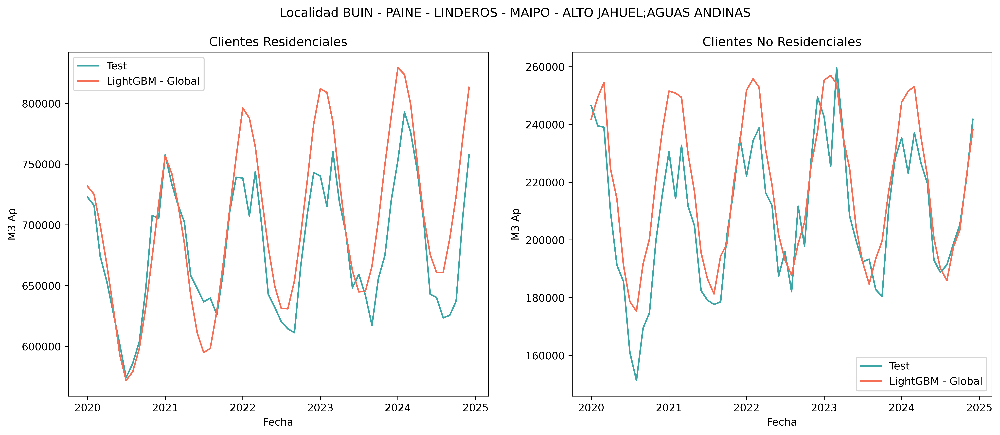

In [32]:
predictions_lgbm_mg["Grupo Cliente"] = predictions_lgbm_mg["id_combinacion"].apply(lambda x: "Residencial" if 'Residencial' in x else "No Residencial")
predictions_lgbm_mg = pd.merge(left=predictions_lgbm_mg, right=df_agua[['Fecha','id_combinacion', 'M3 Ap']], on=["Fecha", "id_combinacion"], how='left')
aux = predictions_lgbm_mg.groupby(by=["Fecha", "Grupo Cliente"], as_index=False)[["M3 Ap", "y_pred"]].sum()

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=600)

sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="M3 Ap", ax=axs[0], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="y_pred", ax=axs[0], label="LightGBM - Global", color = "#F56F57")
axs[0].set_title("Clientes Residenciales")

sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="M3 Ap", ax=axs[1], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="y_pred", ax=axs[1], label="LightGBM - Global", color = "#F56F57")
axs[1].set_title("Clientes No Residenciales")

fig.suptitle('Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

In [33]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,16), dpi=600)
axs = axs.flatten()
for i, combi in enumerate(combination):

    sns.lineplot(data=predictions_lgbm_mg[predictions_lgbm_mg["id_combinacion"] == combi], x="Fecha", y="M3 Ap", ax=axs[i], label="Test", color="#3CA6A6")
    sns.lineplot(data=predictions_lgbm_mg[predictions_lgbm_mg["id_combinacion"] == combi], x="Fecha", y="y_pred", ax=axs[i], label="LightGBM - Global", color = "#F56F57")
    axs[i].set_title(combi)


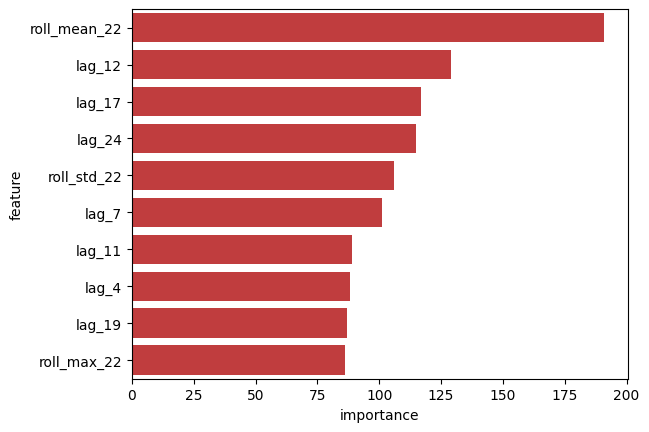

In [31]:
sns.barplot(forecaster.get_feature_importances()[:10], x="importance", y="feature")
plt.show()

In [34]:
pd.concat(
    [
        get_error_metrics(aux[aux["Grupo Cliente"] == "Residencial"]["y_pred"], aux[aux["Grupo Cliente"] == "Residencial"]["M3 Ap"], "LightGBM Global", "Residencial"),
        get_error_metrics(aux[aux["Grupo Cliente"] == "No Residencial"]["y_pred"], aux[aux["Grupo Cliente"] == "No Residencial"]["M3 Ap"], "LightGBM Global", "No Residencial")
    ],
    axis=0
)

,Model,RMSPE,RMSE,MAPE
0,LightGBM Global-Residencial,0.054962,37774.404269,0.041972
0,LightGBM Global-No Residencial,0.072889,14767.329524,0.057928


In [54]:
predictions_lgbm_mg.to_csv('predictions_lgbm_mg.csv', index = False)

## LSTM

### Librerias

In [35]:
# Procesado de datos
# ==============================================================================
import os
import pandas as pd
import numpy as np
from skforecast.datasets import fetch_dataset
import seaborn as sns
# Gráficos
# ==============================================================================
import matplotlib.pyplot as plt
from skforecast.plot import set_dark_theme
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as poff
pio.templates.default = "seaborn"
poff.init_notebook_mode(connected=True)

# Keras
# ==============================================================================
os.environ["KERAS_BACKEND"] = "tensorflow" # 'tensorflow', 'jax´ or 'torch'
import keras
from keras.optimizers import Adam
from keras.losses import MeanSquaredError
from keras.callbacks import EarlyStopping
from keras.models import Model
from keras.layers import (BatchNormalization, Dense,
                TimeDistributed, Bidirectional,
                SimpleRNN, GRU, LSTM, Dropout, Input)
from tensorflow.keras import Sequential
from typing import Union, Optional

if keras.__version__ > "3.0":
    if keras.backend.backend() == "tensorflow":
        import tensorflow
    elif keras.backend.backend() == "torch":
        import torch
    else:
        print("Backend not recognized. Please use 'tensorflow' or 'torch'.")

# Modelado 
# ==============================================================================
import skforecast
from skforecast.deep_learning import ForecasterRnn
from skforecast.deep_learning.utils import create_and_compile_model
from sklearn.preprocessing import (MinMaxScaler, OneHotEncoder)
from skforecast.model_selection import TimeSeriesFold
from skforecast.model_selection import backtesting_forecaster_multiseries

import psutil
import optuna
from optuna import create_study



# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('once')
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
optuna.logging.set_verbosity(optuna.logging.WARNING)


color = '\033[1m\033[38;5;208m' 
print(f"{color}Version skforecast: {skforecast.__version__}")
print(f"{color}Version Keras: {keras.__version__}")
print(f"{color}Using backend: {keras.backend.backend()}")
print(f"{color}Version pandas: {pd.__version__}")
print(f"{color}Version numpy: {np.__version__}")
if keras.__version__ > "3.0":
    if keras.backend.backend() == "tensorflow":
        print(f"{color}Version tensorflow: {tensorflow.__version__}")
    elif keras.backend.backend() == "torch":
        print(f"{color}Version torch: {torch.__version__}")
    else:
        print(f"{color}Version torch: {jax.__version__}")


Version skforecast: 0.16.0
Version Keras: 3.10.0
Using backend: tensorflow
Version pandas: 2.3.1
Version numpy: 1.26.4
Version tensorflow: 2.19.0


In [36]:
import torch
# Mostrar información sobre la GPU y la CPU
# ==============================================================================
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

if device.type == 'cuda':
    print(torch.cuda.get_device_name(0))
    print('Memory Usage:')
    print('Allocated :', round(torch.cuda.memory_allocated(0) / 1024**3, 1), 'GB')
    print('Reserved  :', round(torch.cuda.memory_reserved(0) / 1024**3, 1), 'GB')

print(f"CPU RAM Free: {psutil.virtual_memory().available / 1024**3:.2f} GB")

Using device: cpu
CPU RAM Free: 16.84 GB


### Preprocesamiento

In [37]:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / np.where(y_true == 0, np.nan, y_true)))

def rmse(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

def rmspe(y_true, y_pred):
    return np.sqrt(np.mean(((y_true - y_pred) / np.where(y_true == 0, np.nan, y_true)) ** 2))

In [38]:
def compile_rnn(series, lags, steps, recurrent_units_l1, recurrent_units_l2, dense_units,activation = 'relu', levels: Optional[Union[str, int, list]] = None, recurrent_layer = "LSTM", dropout=0.2, learning_rate=0.01, loss: object = MeanSquaredError(),compile_kwargs: dict = {}):

    n_series = series.shape[1]
    input_layer = Input(shape=(lags, n_series))
    x = input_layer

    recurrent_units = [recurrent_units_l1, recurrent_units_l2]

    if isinstance(recurrent_units, list):
        if len(recurrent_units) > 1 and recurrent_units[-1] == 0:
            recurrent_units = recurrent_units[:-1]

    if isinstance(recurrent_units, int):
        recurrent_units = [recurrent_units]
    if isinstance(dense_units, int):
        dense_units = [dense_units]

    if isinstance(levels, list):
        levels = len(levels)
    elif isinstance(levels, (str)):
        levels = 1
    elif isinstance(levels, type(None)):
        levels = series.shape[1]
    elif isinstance(levels, int):
        pass

    # Dynamically create multiple recurrent layers if recurrent_units is a list
    if isinstance(recurrent_units, list):
        for i, units in enumerate(recurrent_units[:-1]):  # All layers except the last one
            if recurrent_layer == "LSTM":
                x = LSTM(units, activation=activation, return_sequences=True)(x)
            elif recurrent_layer == "RNN":
                x = SimpleRNN(units, activation=activation, return_sequences=True)(x)
            else:
                raise ValueError(f"Invalid recurrent layer: {recurrent_layer}")
            
            x = BatchNormalization()(x)
            x = Dropout(dropout)(x)

        # Last layer without return_sequences
        if recurrent_layer == "LSTM":
            x = LSTM(recurrent_units[-1], activation=activation)(x)
        elif recurrent_layer == "RNN":
            x = SimpleRNN(recurrent_units[-1], activation=activation)(x)
        else:
            raise ValueError(f"Invalid recurrent layer: {recurrent_layer}")
    else:
        # Single recurrent layer
        if recurrent_layer == "LSTM":
            x = LSTM(recurrent_units, activation=activation)(x)
        elif recurrent_layer == "RNN":
            x = SimpleRNN(recurrent_units, activation=activation)(x)
        else:
            raise ValueError(f"Invalid recurrent layer: {recurrent_layer}")

    # Dense layers
    if dense_units is not None:
        for i, nn in enumerate(dense_units):
            x = Dense(nn, activation=activation)(x)
            x = Dropout(dropout)(x)

    # Output layer
    x = Dense(levels * steps, activation="relu")(x)
    output_layer = keras.layers.Reshape((steps, levels))(x)
    model = Model(inputs=input_layer, outputs=output_layer)

    optimizer = Adam(learning_rate=learning_rate)

    model.compile(optimizer=optimizer, loss=loss, **compile_kwargs)
    return model

In [39]:
df = pd.read_csv('Resultados CSV/df_agua_forecast.csv', parse_dates=["Fecha"])
df = df.sort_values(by="Fecha", ascending=True)
df = df.set_index("Fecha", drop=False).rename_axis('idx_fecha')

df = pd.get_dummies(df,columns=['Estacion', 'Tipo'], drop_first=True, dtype=int)

exog_features = [col for col in df.columns if col not in (["Nombre Corto", "Localidad","Tipo Cliente", "M3 Ap", "id_combinacion", "Fecha", "Cargo fijo", "Tarifa sobreconsumo", "T-Max", "T-Min", "HR-18Hrs", "HR-00Hrs",])]
combination = [x for x in df["id_combinacion"].unique() if 'BUIN' in x]

combination

['BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Comercial',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;No Asociado a Inmueble',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Institucional',
 'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial']

In [40]:
combination_1 = combination[2]
combination_1

'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial'

In [41]:
df_ml = df[df["id_combinacion"] == combination_1].asfreq("MS").sort_index()
end_train = '2013-12-01'
end_validation = '2019-12-01'
start_test = '2020-01-01'
end_test = '2024-12-01'

df_train    = df_ml.loc[:end_train,:]
df_val = df_ml.loc[end_train:end_validation,:]
df_test     = df_ml.loc[start_test:,]  # Últimos 60 datos

### Modelo

In [66]:
# Creación del modelo
# ==============================================================================
series = ["M3 Ap"] + exog_features  # Series temporales que se utilizarán para entrenar el modelo.
levels = ["M3 Ap"]  # Serie que se quiere predecir
lags = 16        # Valores pasados a utilizar en la predicción
steps = 60       # Pasos a futuro a predecir

# Selección de las series temporales utilizadas
data = df_ml[series].copy()
data_train = df_train[series].copy()
data_val = df_val[series].copy()
data_test = df_test[series].copy()

In [105]:
def search_space(trial):
    return{
        'lags':trial.suggest_int('lags',2, 12),
        'recurrent_units_l1': trial.suggest_int('recurrent_units_l1',8, 64, step = 4),
        'recurrent_units_l2': trial.suggest_int('recurrent_units_l2',0, 64, step = 8),
        'dense_units': trial.suggest_int('dense_units', 8, 64, step = 8),
        'activation':trial.suggest_categorical('activation',['relu', 'tanh', 'sigmoid']),
        'dropout':trial.suggest_float('dropout', 0.1, 0.5, step=0.1),
        'learning_rate':trial.suggest_float('learning_rate', 0.0001, 0.01, step=0.0001),
        'batch_size':trial.suggest_int('batch_size',4, 64, step=4),
    }

In [ ]:
resultados = []

def objective(trial):
    params = search_space(trial)
    batch_size = params.pop('batch_size')
    lags = params["lags"]
    forecaster = ForecasterRnn(
        regressor = compile_rnn(
            series=data_train,
            levels=levels, 
            steps=steps,
            recurrent_layer="LSTM",
            loss=MeanSquaredError(),
            **params
            ),
        levels=levels,
        steps=steps,
        lags = lags,
        transformer_series=MinMaxScaler(),
        fit_kwargs={
            "epochs": 250,      # Número de épocas para entrenar el modelo.
            "batch_size": batch_size,  # Tamaño del batch para entrenar el modelo.
            "callbacks": [
                EarlyStopping(monitor="val_loss", patience=15)
            ],  # Callback para detener el entrenamiento cuando ya no esté aprendiendo más.
            "series_val": data_val,  # Datos de validación para el entrenamiento del modelo.
            "verbose": 0,
            "device": 'gpu'
        },
    )
    # Backtesting dentro del conjunto de entrenamiento + validación
    cv = TimeSeriesFold(
        steps=forecaster.max_step,
        initial_train_size=len(data.loc[:end_validation, :]), # Datos de entrenamiento + validación
        refit=False,
    )
    metrics, predictions = backtesting_forecaster_multiseries(
        forecaster=forecaster,
        series=data,
        levels=forecaster.levels,
        cv=cv,
        metric=[rmse, mape, rmspe],
        verbose=False,
        show_progress=False,
        random_state=8520
    )

    resultados.append({
        'params': params,
        'lags': lags,
        'batch_size': batch_size,
        'rmse_cv': metrics['rmse'].values[0],
        'mape_cv': metrics['mape'].values[0],
        'rmspe_cv': metrics['rmspe'].values[0],
        'mape_test': mape(df_test["M3 Ap"], predictions['pred']),
        'rmse_test': rmse(df_test["M3 Ap"], predictions['pred']),
        'rmspe_test': rmspe(df_test["M3 Ap"], predictions['pred'])
    })

    return metrics['rmse'].values[0]  # objetivo para minimizar en la búsqueda

sampler = optuna.samplers.TPESampler(seed=8520)
study = create_study(direction='minimize', sampler=sampler)

study.optimize(objective, n_trials=500, show_progress_bar=True, gc_after_trial=True)

In [107]:
# Convertir resultados a DataFrame
resultados_df = pd.DataFrame(resultados)

# Calcular ponderaciones usando normalización min-max (minimizar)
for metric in ['mape_test', 'rmse_test', 'rmspe_test', 'mape_cv', 'rmse_cv', 'rmspe_cv']:
    min_val = resultados_df[metric].min()
    max_val = resultados_df[metric].max()
    resultados_df[f'{metric}_norm'] = (resultados_df[metric] - min_val) / (max_val - min_val)

resultados_df["Ponderacion_test"] = resultados_df[['mape_test_norm', 'rmse_test_norm', 'rmspe_test_norm']].mean(axis=1)
resultados_df["Ponderacion_cv"] = resultados_df[['mape_cv_norm', 'rmse_cv_norm', 'rmspe_cv_norm']].mean(axis=1)
resultados_df["Ponderacion"] = (resultados_df["Ponderacion_cv"] + resultados_df["Ponderacion_test"]) / 2 * 100

resultados_df.sort_values(by="Ponderacion", ascending=True)

,params,lags,batch_size,rmse_cv,mape_cv,rmspe_cv,mape_test,rmse_test,rmspe_test,mape_test_norm,rmse_test_norm,rmspe_test_norm,mape_cv_norm,rmse_cv_norm,rmspe_cv_norm,Ponderacion_test,Ponderacion_cv,Ponderacion
395,"{'lags': 5, 'recurrent_units_l1': 60, 'recurre...",5,48,48436.531487,0.060865,0.072590,0.060865,48436.531487,0.072590,0.003043,0.000000,0.000000,0.003043,0.000000,0.000000,0.001014,0.001014,0.101431
396,"{'lags': 5, 'recurrent_units_l1': 56, 'recurre...",5,48,48944.198563,0.060301,0.073557,0.060301,48944.198563,0.073557,0.000000,0.004023,0.005451,0.000000,0.004023,0.005451,0.003158,0.003158,0.315816
316,"{'lags': 6, 'recurrent_units_l1': 60, 'recurre...",6,48,49376.766705,0.060479,0.072922,0.060479,49376.766705,0.072922,0.000959,0.007451,0.001873,0.000959,0.007451,0.001873,0.003428,0.003428,0.342758
319,"{'lags': 5, 'recurrent_units_l1': 60, 'recurre...",5,48,49022.029871,0.061792,0.073127,0.061792,49022.029871,0.073127,0.008039,0.004640,0.003026,0.008039,0.004640,0.003026,0.005235,0.005235,0.523513
339,"{'lags': 6, 'recurrent_units_l1': 60, 'recurre...",6,44,49120.817482,0.061556,0.073684,0.061556,49120.817482,0.073684,0.006766,0.005423,0.006164,0.006766,0.005423,0.006164,0.006118,0.006118,0.611765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97,"{'lags': 11, 'recurrent_units_l1': 52, 'recurr...",11,64,164939.188566,0.227928,0.234763,0.227928,164939.188566,0.234763,0.903862,0.923279,0.914046,0.903862,0.923279,0.914046,0.913729,0.913729,91.372886
49,"{'lags': 12, 'recurrent_units_l1': 36, 'recurr...",12,44,167084.710559,0.228754,0.237277,0.228754,167084.710559,0.237277,0.908314,0.940282,0.928214,0.908314,0.940282,0.928214,0.925603,0.925603,92.560333
55,"{'lags': 10, 'recurrent_units_l1': 40, 'recurr...",10,56,168538.687200,0.233331,0.239761,0.233331,168538.687200,0.239761,0.932991,0.951805,0.942210,0.932991,0.951805,0.942210,0.942336,0.942336,94.233551
101,"{'lags': 11, 'recurrent_units_l1': 44, 'recurr...",11,60,169339.038930,0.235259,0.241571,0.235259,169339.038930,0.241571,0.943390,0.958148,0.952417,0.943390,0.958148,0.952417,0.951318,0.951318,95.131821


In [113]:
i = 395
params = resultados_df["params"].loc[i]
batch_size = resultados_df["batch_size"].loc[i]
lags = params["lags"]
forecaster = ForecasterRnn(
    regressor = compile_rnn(
        series=data_train,
        levels=levels, 
        steps=steps,
        recurrent_layer="LSTM",
        loss=MeanSquaredError(),
        **params
        ),
    levels=levels,
    steps=steps,
    lags = lags,
    transformer_series=MinMaxScaler(),
    fit_kwargs={
        "epochs": 500,      # Número de épocas para entrenar el modelo.
        "batch_size": batch_size,  # Tamaño del batch para entrenar el modelo.
        "callbacks": [
            EarlyStopping(monitor="val_loss", patience=15)
        ],  # Callback para detener el entrenamiento cuando ya no esté aprendiendo más.
        "series_val": data_val,  # Datos de validación para el entrenamiento del modelo.
        "device": 'gpu'
    },
)

forecaster.regressor.summary()

# Backtesting dentro del conjunto de entrenamiento + validación
cv = TimeSeriesFold(
    steps=forecaster.max_step,
    initial_train_size=len(data.loc[:end_validation, :]), # Datos de entrenamiento + validación
    refit=False,
)
metrics, predictions = backtesting_forecaster_multiseries(
    forecaster=forecaster,
    series=data,
    levels=forecaster.levels,
    cv=cv,
    metric=[rmse, mape, rmspe],
    verbose=False,
    show_progress=False,
    random_state=8052
)


Model: "functional_848"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_848 (InputLayer)    │ (None, 5, 19)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1013 (LSTM)                │ (None, 60)             │        19,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1696 (Dense)              │ (None, 56)             │         3,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1013 (Dropout)          │ (None, 56)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1697 (Dense)              │ (None, 60)             │         3,420 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape_848 (Reshape)           │ (None, 60, 1)          │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,036 (101.70 KB)

 Trainable params: 26,036 (101.70 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2332 - val_loss: 0.2192
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - loss: 0.2190 - val_loss: 0.2030
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - loss: 0.2007 - val_loss: 0.1894
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - loss: 0.1930 - val_loss: 0.1761
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.1836 - val_loss: 0.1613
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - loss: 0.1706 - val_loss: 0.1442
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.1655 - val_loss: 0.1293
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - loss: 0.1507 - val_loss: 0.1178
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.1482 - val_loss: 0.1081
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.1379 - val_loss: 0.0998
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.1355 - val_loss: 0.0909
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.1297 - val_loss

  levels          rmse      mape     rmspe
0  M3 Ap  59187.314032  0.073457  0.087497


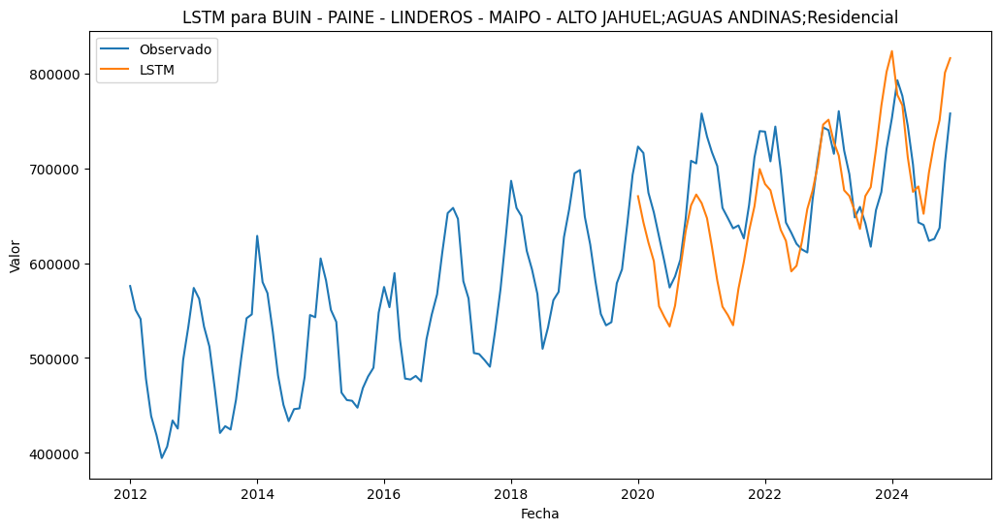

In [114]:
print(metrics)
plt.figure(figsize=(12,6))
plt.title(f"LSTM para {combination_1}")
sns.lineplot(df_ml['M3 Ap'], label="Observado")
sns.lineplot(data=predictions,x = predictions.index, y='pred', label = "LSTM")
plt.xlabel("Fecha")
plt.ylabel("Valor")
plt.legend()
plt.show()

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2871 - val_loss: 0.2773
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.2720 - val_loss: 0.2668
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.2629 - val_loss: 0.2543
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.2738 - val_loss: 0.2413
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 0.2470 - val_loss: 0.2272
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.2234 - val_loss: 0.2128
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.2307 - val_loss: 0.1995
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.1926 - val_loss: 0.1912
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.2118 - val_loss: 0.1858
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.2100 - val_loss: 0.1834
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.1983 - val_loss: 0.1827
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 0.2126 - val_loss

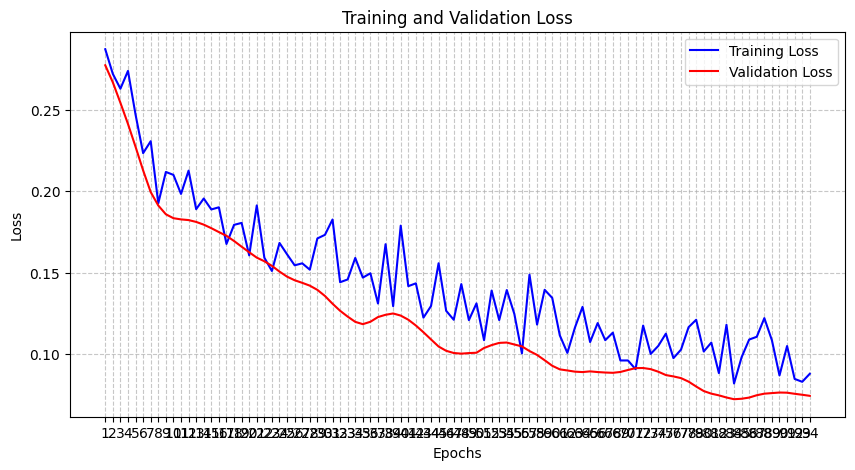

In [98]:
# Entrenamiento del forecaster
# ==============================================================================
forecaster.fit(data_val)# Seguimiento del entrenamiento y overfitting
# ==============================================================================
fig, ax = plt.subplots(figsize=(10, 5))
forecaster.plot_history(ax=ax)

395	{'lags': 5, 'recurrent_units_l1': 60, 'recurrent_units_l2': 0, 'dense_units': 56, 'activation': 'sigmoid', 'dropout': 0.30000000000000004, 'learning_rate': 0.0022}	5	48	48436.531486927706	0.06086535672229141	0.07259001612837908	0.06086535672229141	48436.531486927706	0.07259001612837908	0.0030429431692591932	0.0	0.0	0.0030429431692591932	0.0	0.0	0.0010143143897530643	0.0010143143897530643	0.10143143897530643

Residencial: 98	{'lags': 12, 'recurrent_units_l1': 128, 'recurrent_units_l2': 0, 'dense_units': 32, 'activation': 'relu', 'dropout': 0.4, 'learning_rate': 0.0013891299420126305}	12	32	50787.191313856514	0.0640840076144676	0.07618796507897187	0.0640840076144676	50787.191313856514	0.07618796507897187	0.2307500131639065	0.2307500131639065	23.07500131639065

Comercial: 58	{'lags': 12, 'recurrent_units_l1': 128, 'recurrent_units_l2': 0, 'dense_units': 16, 'activation': 'tanh', 'dropout': 0.30000000000000004, 'learning_rate': 0.009990760402421563}	12	64	11730.531888566396	0.06278924363496875	0.07917894842940981	0.7639733919027947	521817.63091350044	0.7640272979204664	0.9772555409225413	0.3010702596329346	63.91629002777379

No asociado a inmueble: 12	{'lags': 12, 'recurrent_units_l1': 80, 'recurrent_units_l2': 0, 'dense_units': 16, 'activation': 'relu', 'dropout': 0.2, 'learning_rate': 0.0011787846047779196}	12	32	8175.854612297718	0.19365268728850846	0.24183837228212537	0.9522760483381745	648937.6488811369	0.9523906549605786	0.9795084599267084	0.4113206784160654	70.02284936531952

Institucional 63	{'lags': 12, 'recurrent_units_l1': 120, 'recurrent_units_l2': 0, 'dense_units': 16, 'activation': 'tanh', 'dropout': 0.5, 'learning_rate': 0.0010593460597142518}	12	32	584.233743994511	0.14785269477988167	0.1865031091070087	0.14785269477988167	584.233743994511	0.1865031091070087	0.08807324724527128	0.08807324724527128	8.807324724527128

Industrial 99	{'lags': 12, 'recurrent_units_l1': 48, 'recurrent_units_l2': 0, 'dense_units': 48, 'activation': 'tanh', 'dropout': 0.30000000000000004, 'learning_rate': 0.00525488409907627}	12	64	3788.5715764691226	0.20478274421968642	0.22726382465833286	0.20478274421968642	3788.5715764691226	0.22726382465833286	0.49888110947169356	0.49888110947169356	49.88811094716936

In [14]:
lstm_params = {'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial': {'lags': 5, 'recurrent_units_l1': 60, 'recurrent_units_l2': 0, 'dense_units': 56, 'activation': 'sigmoid', 'dropout': 0.30000000000000004, 'learning_rate': 0.0022, 'batch_size':48},
               'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Comercial':	{'lags': 12, 'recurrent_units_l1': 128, 'recurrent_units_l2': 0, 'dense_units': 16, 'activation': 'tanh', 'dropout': 0.30000000000000004, 'learning_rate': 0.009990760402421563, 'batch_size':64},
               'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;No Asociado a Inmueble': {'lags': 12, 'recurrent_units_l1': 80, 'recurrent_units_l2': 0, 'dense_units': 16, 'activation': 'relu', 'dropout': 0.2, 'learning_rate': 0.0011787846047779196, 'batch_size':32},
               'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Institucional':	{'lags': 12, 'recurrent_units_l1': 120, 'recurrent_units_l2': 0, 'dense_units': 16, 'activation': 'tanh', 'dropout': 0.5, 'learning_rate': 0.0010593460597142518, 'batch_size':32},
               'BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial': {'lags': 12, 'recurrent_units_l1': 48, 'recurrent_units_l2': 0, 'dense_units': 48, 'activation': 'tanh', 'dropout': 0.30000000000000004, 'learning_rate': 0.00525488409907627, 'batch_size':64}
}

In [15]:
pd.DataFrame(lstm_params)

,BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Residencial,BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Comercial,BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;No Asociado a Inmueble,BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Institucional,BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS;Industrial
lags,5,12,12,12,12
recurrent_units_l1,60,128,80,120,48
recurrent_units_l2,0,0,0,0,0
dense_units,56,16,16,16,48
activation,sigmoid,tanh,relu,tanh,tanh
dropout,0.3,0.3,0.2,0.5,0.3
learning_rate,0.0022,0.009991,0.001179,0.001059,0.005255
batch_size,48,64,32,32,64


#### Resultados

In [54]:
df_resultados = pd.DataFrame()

fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(16,12), dpi=600)
axs= axs.flatten()

for i, combi in enumerate(combination):
    params = lstm_params[combi]
    batch_size = params.pop("batch_size")
    lags = params["lags"]

    df_ml = df[df["id_combinacion"] == combi].asfreq("MS").sort_index()
    series = ["M3 Ap"] + exog_features  # Series temporales que se utilizarán para entrenar el modelo.
    levels = ["M3 Ap"]  # Serie que se quiere predecir
    steps = 60       # Pasos a futuro a predecir

    # Selección de las series temporales utilizadas
    data = df_ml[series].copy()
    data_train = df_ml.loc[:end_train,:][series].copy()
    data_val = df_ml.loc[end_train:end_validation,:][series].copy()
    data_test = df_ml.loc[start_test:,][series].copy()  

    forecaster = ForecasterRnn(
        regressor = compile_rnn(
            series=data_train,
            levels=levels, 
            steps=steps,
            recurrent_layer="LSTM",
            loss=MeanSquaredError(),
            **params
            ),
        levels=levels,
        steps=steps,
        lags = lags,
        transformer_series=MinMaxScaler(),
        fit_kwargs={
            "epochs": 500,      # Número de épocas para entrenar el modelo.
            "batch_size": batch_size,  # Tamaño del batch para entrenar el modelo.
            "callbacks": [
                EarlyStopping(monitor="val_loss", patience=10)
            ],  # Callback para detener el entrenamiento cuando ya no esté aprendiendo más.
            "series_val": data_val,  # Datos de validación para el entrenamiento del modelo.
        },
    )

    # Backtesting dentro del conjunto de entrenamiento + validación
    cv = TimeSeriesFold(
        steps=forecaster.max_step,
        initial_train_size=len(data.loc[:end_validation, :]), # Datos de entrenamiento + validación
        refit=False,
    )
    metrics, predictions = backtesting_forecaster_multiseries(
        forecaster=forecaster,
        series=data,
        levels=forecaster.levels,
        cv=cv,
        metric=[rmse, mape, rmspe],
        verbose=False,
        show_progress=False,
        random_state=8052

    )
    
    df_resultados = pd.concat([df_resultados, pd.DataFrame({
        'id_combinacion': combi,
        'Fecha': data.loc[start_test:,"M3 Ap"].index,
        'M3 Ap': data.loc[start_test:,"M3 Ap"].values,
        'y_pred': predictions["pred"].values

    })
    ], ignore_index=True)


    mape_test = mape(data_test["M3 Ap"], predictions["pred"])
    rmse_test = rmse(data_test["M3 Ap"], predictions["pred"])
    rmspe_test = rmspe(data_test["M3 Ap"], predictions["pred"])

    print(f"MAPE: {mape_test}, RMSE: {rmse_test}, RMSPE: {rmspe_test}")
    sns.lineplot(data=data, x="idx_fecha", y="M3 Ap", ax=axs[i], label="Test", color="#3CA6A6")
    sns.lineplot(data=predictions, x= predictions.index, y="pred",ax=axs[i], label="LSTM", color="#864CA1")
    axs[i].set_title(combi)

Epoch 1/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 696ms/step - loss: 0.2619 - val_loss: 0.1478
Epoch 2/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.2179 - val_loss: 0.1662
Epoch 3/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.1845 - val_loss: 0.1490
Epoch 4/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.1605 - val_loss: 0.1230
Epoch 5/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.1457 - val_loss: 0.1044
Epoch 6/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.1377 - val_loss: 0.0925
Epoch 7/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.1266 - val_loss: 0.0912
Epoch 8/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.1209 - val_loss: 0.0844
Epoch 9/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.1135 - val_loss: 0.0772
Epoch 10/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 0.1043 - val_loss: 0.0739
Epoch 11/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0945 - val_loss: 0.0753
Epoch 12/500
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0880 - val_l

Text(0.5, 0.98, 'Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

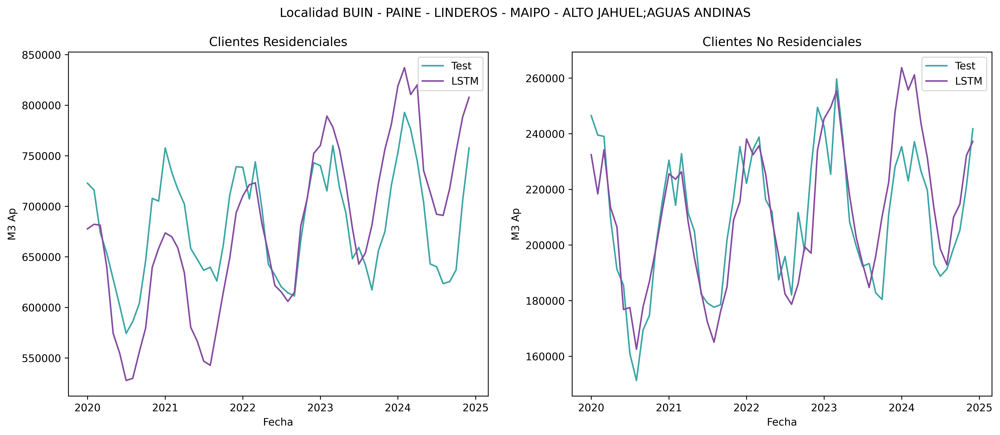

In [55]:
df_resultados["Grupo Cliente"] = df_resultados["id_combinacion"].apply(lambda x: "Residencial" if 'Residencial' in x else "No Residencial")

aux = df_resultados.groupby(by=["Fecha", "Grupo Cliente"], as_index=False)[["M3 Ap", "y_pred"]].sum()

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=600)

sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="M3 Ap", ax=axs[0], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "Residencial"], x="Fecha", y="y_pred", ax=axs[0], label="LSTM", color = "#864CA1")
axs[0].set_title("Clientes Residenciales")

sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="M3 Ap", ax=axs[1], label="Test", color="#3CA6A6")
sns.lineplot(data=aux[aux["Grupo Cliente"] == "No Residencial"], x="Fecha", y="y_pred", ax=axs[1], label="LSTM", color = "#864CA1")
axs[1].set_title("Clientes No Residenciales")

fig.suptitle('Localidad BUIN - PAINE - LINDEROS - MAIPO - ALTO JAHUEL;AGUAS ANDINAS')

In [58]:
df_resultados.to_csv("lstm_prediction.csv", index=False)

In [57]:
pd.concat(
    [
        get_error_metrics(aux[aux["Grupo Cliente"] == "Residencial"]["y_pred"], aux[aux["Grupo Cliente"] == "Residencial"]["M3 Ap"], "LSTM", "Residencial"),
        get_error_metrics(aux[aux["Grupo Cliente"] == "No Residencial"]["y_pred"], aux[aux["Grupo Cliente"] == "No Residencial"]["M3 Ap"], "LSTM", "No Residencial")
    ])


,Model,RMSPE,RMSE,MAPE
0,LSTM-Residencial,0.080926,54146.516392,0.068909
0,LSTM-No Residencial,0.065666,13786.512037,0.053089
